#Plant Care Recommender




A common barrier to owning plants, and a reason why people tend to stay away from them, is that they are perceived as needing extensive knowledge and experience, leading many to give up after initial failures. [Victorin](https://github.com/leobrod44/Victorin) is a system designed to overcome this by automating watering and alerting users to necessary watering or critical dryness. While automated watering prevents common problems such as critical dryness or root rot from overwatering, optimal plant health also depends on suitable soil, lighting, and temperature. To simplify plant care and eliminate the need for in-depth research, this notebook will develop a model that can analyze a plant image and accurately recommend these vital environmental parameters.


#### Best Model architecture

<img src="https://drive.google.com/uc?export=view&id=1NSj1qrykVnmWBP-ptMJQKB8Zb_sd8tXa"
     alt="Best Model Architecture"
     style="width: 100%; height: auto; display: block; margin: 0 auto;" />



Import the libraries used throughout the project

In [56]:

import zipfile
import os
import PIL
import numpy as np
import matplotlib.pyplot as plt
import torch
from torch.utils.data import Dataset, DataLoader, TensorDataset
from torchvision import transforms
from PIL import Image
import os
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import csv
import random
import datetime
import copy
from tqdm import tqdm
from scipy.stats import gaussian_kde
import pandas as pd
from IPython.display import display
from matplotlib.gridspec import GridSpec
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
import torchvision.models as models
from torch.optim.lr_scheduler import StepLR
from torch.utils.data import TensorDataset, DataLoader
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
from torch.optim.lr_scheduler import ReduceLROnPlateau
from enum import Enum
from sklearn.metrics import accuracy_score
from tabulate import tabulate
from abc import ABC, abstractmethod

import base64
from io import BytesIO
from PIL import Image
import torchvision.transforms as transforms

from IPython.display import HTML, display
import pandas as pd
import torch
from torchvision import transforms
from PIL import Image
from io import BytesIO
import base64

Switch environment depending on if the runtime is connected to a local jupyter environment, or is hosted on cloud. This was done to benefit from my Nvidia 4070 super, having 7,168 cuda cores vs the remote T4 GPU which has 2560 cuda cores.

In [57]:

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
if torch.cuda.is_available():
    cuda_device_index = torch.cuda.current_device()
    print(f"CUDA Device: {torch.cuda.get_device_name(cuda_device_index)}")
else:
    print("CUDA is not available. Running on CPU.")



CUDA Device: NVIDIA GeForce RTX 4070 SUPER


### Dataset



The data used for this project consists of scraped plant images using selenium [[scraper]](https://github.com/leobrod44/Plant-Care-Recommender/blob/main/data-collection/scraper/image_scraper.py).

Each image name requested searches for the image name with 'in pot' appended for best results since working with house plants. The requested count of each plant type is then downloaded.

<img src="https://drive.google.com/uc?id=1b8tR21ImubLv9_6RuZdSo_6qHMjoa7WT" alt="Image description" width="850"/>

&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;*Figure N: Image Scrapper*&nbsp;&nbsp;

We also need the plant care data, using a similar method, we can also scrape plant info on various websites such as [[MissouriBotanical]](https://www.missouribotanicalgarden.org/PlantFinder/PlantFinderDetails.aspx?taxonid=276378&isprofile=0&basic=monstera%20deliciosa)

<img src="https://drive.google.com/uc?id=1sHxwsoJSjeS5lEwDEr9z0vW7ltbdwP9H" alt="Image description" width="450"/>

However, the information gathered tends to be rather vague (ex: Water: Medium). For optimal resulsts, we want more precise values. Prompting a large language model with the specific requirements to build a csv file is more reliable.

Randomized buffers are used to avoid bot detection, but make the process of gathering data time consuming. The following datasets were built by letting the scraper run overnight on multiple instances.

[dataset1](https://drive.google.com/file/d/1IscwZ0kLV1cF06w2hrf6RVZaFPAHjIU0/view?usp=drive_link): 14 classes, 4.2k images

[dataset2](): 71 classes, 3.7k images

[dataset3](
https://drive.google.com/file/d/1sclRdWewudIXzI2gE6WSulNqYPQiLkxn/view?usp=drive_link): 60 classes 9k images,

For demo purposes, use 14_classes_4.2k, but feel free to use the other datasets.

In [58]:
import os
import zipfile

try:
    # Remote dev environment
    import gdown

    content_path = '/content/data/dataset1'
    zip_path = '/content/14_classes_4.2k.zip'
    file_id = '1IscwZ0kLV1cF06w2hrf6RVZaFPAHjIU0'

    # content_path = '/content/data/dataset2'
    # zip_path = '/content/60_classes_9.4k.zip'
    # file_id = '1sclRdWewudIXzI2gE6WSulNqYPQiLkxn'

    # content_path = '/content/data/dataset3'
    # zip_path = '/content/71_classes_3.7k.zip'
    # file_id = '1CdtQ-D6CZpMM7z5-ulIP5y42bl4piiLg'

    zip_url = f'https://drive.google.com/uc?id={file_id}'

    gdown.download(zip_url, zip_path, quiet=False, fuzzy=True)
    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        zip_ref.extractall('/content/data')

except ImportError:
    # Local dev environment
    content_path = '/home/singouini/Projects/Victorin/ml/dataset2/'



PlantDataset extends torch dataset, and will load data from the image folders and from csv. It builds entries and storing the image path to load images only first reference.

In [59]:

def load_image(image_path, transform = None):
    """Loads images and converts RGBA images to RGB to have same format accross dataset. """
    try:
        image = Image.open(image_path)
        if image.mode == "P" and "transparency" in image.info:
            image = image.convert("RGBA")

            image = image.convert("RGB")
        else:
            image = image.convert('RGB')

        if transform:
            image = transform(image)
        return image

    except Exception as e:
        print(f"Error loading image: {image_path}, Error: {e}")
        return None


class PlantEntry():
    """Represents an entry in the dataset."""
    def __init__(self, name, image_path, features):
        self.name = name
        self.image_path = image_path
        self.features = features
        # Set to none to return later on dataset reference
        self.image = None


class PlantDataset(Dataset):
    def __init__(self, data_dir, transform=None):
        self.entries = []
        self.transform = transform
        self.data_dir = data_dir

    def load_data(self, data_dir):
        """
        Loads data from the specified directory.
        Creates PlantEntry objects for each image in the dataset.
        Variety of checks in place to ensure proper format for loading

        !IMPORTANT!
          - Images must be in the /images directory
          - care_data.csv (containing plant care data) must be at the same level as the /images directory
        """
        image_folders = os.listdir(os.path.join(data_dir, 'images'))
        plant_data = {}
        with open(os.path.join(data_dir, 'care_data.csv'), 'r', newline='', encoding='utf-8') as care_data:
            reader = csv.DictReader(care_data)
            for row in reader:
                plant_data[row["plant_name"].replace('_', ' ')] = {
                    "watering_interval": float(row["watering_interval_days"]),
                    "sunlight_hours": float(row["sunlight_hours_per_day"]),
                    "sunlight_type": row["sunlight_type"],
                    "critical_moisture": float(row["soil_moisture_percentage"]),
                    "temperature": float(row["temperature_celsius"]),
                    "soil_type": row["soil_type"]
                }
        for folder in image_folders:
            folder_dir = os.path.join(data_dir, 'images', folder)
            label = folder.replace('in_pot', '').replace('_', ' ')[:-1]

            if label in plant_data:
                for filename in os.listdir(folder_dir):
                    if '.json' in filename:
                        continue
                    image_path = os.path.join(folder_dir, filename)
                    self.entries.append(
                        PlantEntry(
                            label,
                            image_path,
                            plant_data[label]
                        )
                    )
            else:
                print(f"Label {label} not found in care_data.csv")

    def preload(self):
        """Preloads all images in the dataset."""
        for entry in self.entries:
            load_image(entry.image_path, self.transform)

    def __len__(self):
        """Returns the number of entries in the dataset."""
        return len(self.entries)

    def get_features(self, idx):
        """Returns the features of the entry at the given index."""
        return self.entries[idx].features, self.entries[idx].name

    def feature_classes(self, feature):
        """Returns the unique values of a specific feature."""
        return set(entry.features[feature] for entry in self.entries)

    def get_feature(self, idx, feature):
        """Returns the value of a specific feature for the entry at the given index."""
        plant_entry = self.entries[idx]
        return plant_entry.features[feature], plant_entry.name

    def __getitem__(self, idx):
        """
        Returns the image and labels for the entry at the given index.
        Takes care of loading the image if it is not already loaded.
        Returns label tensors for each feature.
        """
        plant_entry = self.entries[idx]
        image_path = plant_entry.image_path

        # Prevent reloading image if already referenced
        if plant_entry.image is None:
            plant_entry.image = load_image(image_path, transform=self.transform)

        # Build label Tensor tuple
        labels = (
          torch.tensor([plant_entry.features['watering_interval']], dtype=torch.float32),
          torch.tensor([plant_entry.features['sunlight_hours']], dtype=torch.float32),
          torch.tensor(plant_entry.features['sunlight_type'], dtype=torch.int64) ,
          torch.tensor([plant_entry.features['critical_moisture']], dtype=torch.float32),
          torch.tensor([plant_entry.features['temperature']], dtype=torch.float32),
          torch.tensor(plant_entry.features['soil_type'], dtype=torch.int64) ,
          torch.tensor(plant_entry.name, dtype=torch.int64)
        )

        return plant_entry.image, labels




###Preprocessing


The transformations below will be applied to each image once they are loaded.
Since ResNet50 was trained on 224 x 224 pixel images with RGB channel means of [0.485, 0.456, 0.406] and standard deviations of [0.229, 0.224, 0.225], plant images will be scaled and normalized accordingly. This normalization reduces the impact of covariate shift and also helps with feature scaling, which can speed up training and improve convergence.
The remaining transformations, being resizing, rotating, flipping, adjusting brightness/contrast, and normalizing are used for the sake of `data augmentation` which will artificially increase the diversity of the dataset and thus `improve the model's generalization`.


#### Calathea: original vs transformed
<img src="https://drive.google.com/uc?id=1fY3lhbX_EnoczjusjPbQE8vHgdU-6p86" alt="Image description" width="255"/>
<img src="https://drive.google.com/uc?id=1FoCVmXEkHhlG1qUp7j5pVx6C4S1fIFD2" alt="Image description" width="255"/>

#### Convallaria majalis: original vs transformed
<img src="https://drive.google.com/uc?id=17XaC2S1x5Cqr0UTINEgnfHwxzYIHJHJj" alt="Image description" width="255"/>
<img src="https://drive.google.com/uc?id=1Fm7H0pok8qyx7VJ5iHpKEXRJusxLv_Z_" alt="Image description" width="255"/>

A different transform is used on testing images that will only apply ResNet50 scale changes, since testing data should be `independent`

Label encoding is performed on categorical variables such as plant names, soil types, and sunlight types. Encoding transforms these categorical labels into numerical values, making them suitable for feeding into the neural network model.

Data Loaders: The training and testing datasets are then loaded into PyTorch DataLoader objects. These objects efficiently manage batching and shuffling of the data, allowing the model to process batches of data during training and evaluation. The training data is shuffled to introduce randomness and prevent the model from overfitting, while the test data is not shuffled to ensure consistent evaluation.

In [60]:
# Training image transform
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.RandomHorizontalFlip(),
    transforms.RandomRotation(10),
    transforms.CenterCrop(224),
    transforms.ColorJitter(brightness=0.1, contrast=0.1),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

# Test image transform
test_transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

## Initialize and load the dataset
## Note: this will only assign image paths to be loaded upon reference
dataset = PlantDataset(content_path, transform=transform)
dataset.load_data(content_path)



When splitting the training and testing set it is important to first shuffle the dataset before since you otherwise end up with a training set that is biased or unrepresentative of the overall dataset, which will lead to poor generalization on unseen data.

The random seed defaulted to 42, it shouldn't be changed for the sake of reproducability

A deepcopy of the original set is used to create the new sets to avoid referencing a value in one set that has been modified another (caused many issues)


In [61]:
def split_train_test(self, test_transform=None, test_size=0.2, random_state=42):
    """Splits the dataset into training and testing sets."""
    total = len(self.entries)
    indices = list(range(total))

    random.seed(random_state)
    random.shuffle(indices)

    test_count = int(total * test_size)
    test_indices = indices[:test_count]
    train_indices = indices[test_count:]

    #
    train_entries = [copy.deepcopy(self.entries[i]) for i in train_indices]
    test_entries = [copy.deepcopy(self.entries[i]) for i in test_indices]

    train_dataset = PlantDataset(self.data_dir, self.transform)
    test_dataset = PlantDataset(self.data_dir, test_transform)

    train_dataset.entries = train_entries
    test_dataset.entries = test_entries

    return train_dataset, test_dataset, train_indices, test_indices

PlantDataset.split_train_test = split_train_test

With images for model inputs taken care of, we now need to tackle labels. From the previous image examples, here are their associated plant care data retrieve from the csv file. As we can see in the table below, we are dealing with both instances of `Classification` and `Regression`

| Plant Name                               | Watering Interval (days) | Sunlight Hours (hrs/day) | Sunlight Type         | Temperature (°C) | Critical Moisture (%) | Soil Type               |
|------------------------------------------|--------------------------|--------------------------|-----------------------|------------------|-----------------------|-------------------------|
| Lily of the Valley (Convallaria_majalis) | 6                        | 4                        | Medium Indirect Light | 45               | 18                     | General Purpose Potting |
| Calathea (Calathea)                      | 6                        | 5                        | Medium Indirect Light | 45               | 21                     | General Purpose Potting |


As discussed earlier in the context of image preprocessing, normalization is crucial for reducing the impact of different ranges in the features and speeding up the convergence during training. To ensure consistency the labels used for regression, let's normalize them.

Furthermore, our classification labels are currently string values. We need `label encoding` to transform these categorical labels into numerical values for them to be possible to be compared with the model outputs.



In [62]:

def calculate_stats(data_list):
    """Calculates the mean and standard deviation of a list of numerical data."""
    n = len(data_list)
    if n == 0:
        return 0, 1  #div 0 check
    mean = sum(data_list) / n
    std = (sum((x - mean) ** 2 for x in data_list) / n) ** 0.5
    return mean, std


def scale_and_normalize(self):

    # Extract all original values
    watering_intervals = [entry.features['watering_interval'] for entry in self.entries]
    sunlight_hours = [entry.features['sunlight_hours'] for entry in self.entries]
    critical_moistures = [entry.features['critical_moisture'] for entry in self.entries]
    temperatures = [entry.features['temperature'] for entry in self.entries]

    # Calculate mean and standard deviation for numerical features
    watering_mean, watering_std = calculate_stats(watering_intervals)
    sunlight_mean, sunlight_std = calculate_stats(sunlight_hours)
    moisture_mean, moisture_std = calculate_stats(critical_moistures)
    temperature_mean, temperature_std = calculate_stats(temperatures)

    # Update entries with normalized values using the original values
    for i, entry in enumerate(self.entries):
        entry.features['watering_interval'] = (watering_intervals[i] - watering_mean) / watering_std
        entry.features['sunlight_hours'] = (sunlight_hours[i] - sunlight_mean) / sunlight_std
        entry.features['critical_moisture'] = (critical_moistures[i] - moisture_mean) / moisture_std
        entry.features['temperature'] = (temperatures[i] - temperature_mean) / temperature_std

    # Normalization parameters returned to later scale values back to original values
    normalization_params = {
        'watering_interval': {'mean': watering_mean, 'std': watering_std},
        'sunlight_hours': {'mean': sunlight_mean, 'std': sunlight_std},
        'critical_moisture': {'mean': moisture_mean, 'std': moisture_std},
        'temperature': {'mean': temperature_mean, 'std': temperature_std}
    }

    return normalization_params

def scale_label(norm_params, tensor, feature):
    """Scales a tensor of labels for a specific feature."""
    mean = norm_params[feature]['mean']
    std = norm_params[feature]['std']
    return (tensor - mean) / std

def descale_label(norm_params, tensor, feature):
    """Descales a tensor of normalized labels for a specific feature."""
    mean = norm_params[feature]['mean']
    std = norm_params[feature]['std']
    return (tensor * std) + mean

def encode_labels(self, name_encoder, soil_type_encoder, sunlight_type_encoder):
    """Encodes categorical labels using provided encoders."""

    # Retrieve original labels
    soil_types_original = [entry.features['soil_type'] for entry in self.entries]
    sunlight_types_original = [entry.features['sunlight_type'] for entry in self.entries]
    plant_names_original = [entry.name for entry in self.entries]

    # Fit labels to associated encoder
    soil_types_encoded = soil_type_encoder.fit_transform(soil_types_original)
    sunlight_types_encoded = sunlight_type_encoder.fit_transform(sunlight_types_original)
    plant_names_encoded = name_encoder.fit_transform(plant_names_original)

    # Update entries
    for i, entry in enumerate(self.entries):
        entry.features['soil_type'] = soil_types_encoded[i]
        entry.features['sunlight_type'] = sunlight_types_encoded[i]
        entry.name = plant_names_encoded[i]

def delabel_categorical(label_encoder, encoded_value):
    """Delabels a categorical encoded value."""
    if label_encoder and isinstance(encoded_value, (int, float)):
        try:
            return label_encoder.inverse_transform([int(encoded_value)])[0]
        except IndexError:
            return "Unknown"
    return encoded_value

PlantDataset.scale_and_normalize = scale_and_normalize
PlantDataset.encode_labels = encode_labels


Next, split the dataset, scale the regression dataset labels, and encode the classification labels. The test set labels are also encoded for simpler accuracy scoring during training loops.

In [63]:
# Split test and training dataset
train_dataset, test_dataset, train_idx, test_idx = dataset.split_train_test(test_transform)

# Retrive normalization paramaters for future rescaling
normalization_params = train_dataset.scale_and_normalize()

# Encode labels
name_encoder = LabelEncoder()
soil_type_encoder = LabelEncoder()
sunlight_type_encoder = LabelEncoder()
train_dataset.encode_labels(name_encoder,soil_type_encoder,sunlight_type_encoder)
test_dataset.encode_labels(name_encoder,soil_type_encoder,sunlight_type_encoder)


## Models


Visualization functions: Run the following cells to help visualize training statistics

In [64]:
def plot_training_history(histories):
    """
    Training and validation metrics visualization generic for all future tasks.

    Args:
        histories (dict): Dictionary mapping model labels to a list of training phase
        histories. Each phase history is a dictionary containing metric names as keys
        and lists of values per epoch. It allows to compare multiple models
    """
    merged_histories = {}
    for label, history_phases in histories.items():
        merged = {}
        for phase in history_phases:
            for key, values in phase.items():
                if key not in merged:
                    merged[key] = []
                merged[key].extend(values)
        merged_histories[label] = merged
    categories = [
        {
            'name': 'Watering Interval',
            'metrics': [
                ('watering_interval_train_loss', 'watering_interval_val_loss', 'Loss'),
                ('watering_interval_train_ind', 'watering_interval_val_ind', 'RMSE')
            ]
        },
        {
            'name': 'Sunlight Hours',
            'metrics': [
                ('sunlight_hours_train_loss', 'sunlight_hours_val_loss', 'Loss'),
                ('sunlight_hours_train_ind', 'sunlight_hours_val_ind', 'RMSE')
            ]
        },
        {
            'name': 'Temperature',
            'metrics': [
                ('temperature_train_loss', 'temperature_val_loss', 'Loss'),
                ('temperature_train_ind', 'temperature_val_ind', 'RMSE')
            ]
        },
        {
            'name': 'Critical Moisture',
            'metrics': [
                ('critical_moisture_train_loss', 'critical_moisture_val_loss', 'Loss'),
                ('critical_moisture_train_ind', 'critical_moisture_val_ind', 'RMSE')
            ]
        },
        {
            'name': 'Sunlight Type',
            'metrics': [
                ('sunlight_type_train_loss', 'sunlight_type_val_loss', 'Loss'),
                ('sunlight_type_train_ind', 'sunlight_type_val_ind', 'Accuracy')
            ]
        },
        {
            'name': 'Soil Type',
            'metrics': [
                ('soil_type_train_loss', 'soil_type_val_loss', 'Loss'),
                ('soil_type_train_ind', 'soil_type_val_ind', 'Accuracy')
            ]
        },
        {
            'name': 'Plant Identification',
            'metrics': [
                ('plant_name_train_loss', 'plant_name_val_loss', 'Loss'),
                ('plant_name_train_ind', 'plant_name_val_ind', 'Accuracy')
            ]
        },
        {
            'name': 'Overall Training',
            'metrics': [
                ('train_loss', 'val_loss', 'Loss'),
            ]
        }
    ]
    plt.style.use('dark_background')
    loss_colors = ['#e70023', '#faa82a', '#ed69ff', '#67b5f9']
    metric_colors = ['#47a046', '#f8ff14', '#ee22ff', '#58ff2b']
    categories_to_plot = []
    for category in categories:
        available_metrics = []
        for train_key, val_key, title in category['metrics']:

            for history in merged_histories.values():
                if train_key in history and val_key in history:

                    available_metrics.append((train_key, val_key, title))
                    break

        if available_metrics:

            categories_to_plot.append({
                'name': category['name'],
                'metrics': available_metrics
            })

    if not categories_to_plot:
        print("No metrics found to plot.")
        return
    for idx, category in enumerate(categories_to_plot):
        if not category['metrics']:
            continue
        fig, axes = plt.subplots(
            1,
            len(category['metrics']),
            figsize=(7 * len(category['metrics']), 6),
            squeeze=False
        )

        axes = axes[0]

        for i, (train_key, val_key, title) in enumerate(category['metrics']):
            ax = axes[i]
            color_palette = loss_colors if 'loss' in train_key else metric_colors
            models_with_data = []
            for label, history in merged_histories.items():
                if train_key in history and val_key in history:
                    models_with_data.append(label)
            for j, label in enumerate(models_with_data):
                history = merged_histories[label]
                epochs = range(1, len(history[train_key]) + 1)
                color_idx = j % len(color_palette)
                line_color = color_palette[color_idx]
                train_values = history[train_key]
                val_values = history[val_key]
                if isinstance(train_values[0], torch.Tensor):
                    train_values = [v.cpu().item() if v.requires_grad else v.cpu().numpy().item() for v in train_values]

                if isinstance(val_values[0], torch.Tensor):
                    val_values = [v.cpu().item() if v.requires_grad else v.cpu().numpy().item() for v in val_values]

                ax.plot(epochs, train_values,
                        label=f'{label} Train',
                        color=line_color,
                        linewidth=2,
                        marker='o',
                        markersize=4)

                ax.plot(epochs, val_values,
                        label=f'{label} Val',
                        color=line_color,
                        linewidth=2,
                        linestyle='--',
                        alpha=0.7)

            ylabel = 'Loss' if 'loss' in train_key else ('Accuracy' if 'accuracy' in title.lower() else 'RMSE')
            ax.set_title(f"{title}", fontsize=14, pad=10)
            ax.set_xlabel('Epochs', fontsize=12)
            ax.set_ylabel(ylabel, fontsize=12)
            ax.grid(True, linestyle='--', alpha=0.3)
            ax.legend(fontsize=10)


            ax.spines['top'].set_visible(False)
            ax.spines['right'].set_visible(False)
            ax.spines['bottom'].set_alpha(0.3)
            ax.spines['left'].set_alpha(0.3)

        # Add an overall title
        fig.suptitle(f'{category["name"]} Metrics', fontsize=18, y=0.98)

        plt.tight_layout(rect=[0, 0, 1, 0.95])
        plt.savefig(f'plant_care_{category["name"].lower().replace(" ", "_")}_metrics.png',
                   facecolor='black', dpi=300, bbox_inches='tight')

    plt.show()


ResNet50 is a deep convolutional neural network
originally trained on the ImageNet1K dataset containing over 1.2 million images
with 1,000 label classification.

It uses residual and skip connections that mitigate the vanishing gradient problem in deep networks,

In the following models, i'll be leveraging the pretrained ResNet50 as a fixed feature extractor by extending it to my own use cases and eventually fine tuning the internal resnet layers.

### Plant Identification

A good start to get the feel of the model and our data would be to attempt to fine tune this model to identify our different plant classes.




Resnet's convolution layers have already learned to extract features from images. Since our dataset has similar types of images, there is no need to add additional convolutional layers. Instead, I will simply modify and extend the final classfication layer while keeping the previous layers tuned to ImageNet10k frozen.

Our new model head will take advantage of:

`Dropout`: Randomly removes neurons from network to prevent co-adaptation between neurons. This helps avoid overfitting. On inference, dropout is skipped and weights are rescalled back based on the dropout factor

`BatchNorm1D`: Stabilizes layer inputs which helps reduce covariate shift. Which speeds up training and leads to better convergence

`ReLU`: Applied on each layer to introduce non-linearity to the equation



In [65]:

class ClassificationHead(nn.Module):
    def __init__(self, in_features, num_classes, dropout_rate=0.1):
        super(ClassificationHead, self).__init__()
        self.model = nn.Sequential(
            nn.Dropout(dropout_rate),
            nn.Linear(in_features, 512),
            nn.BatchNorm1d(512),
            nn.ReLU(),
            nn.Dropout(dropout_rate),
            nn.Linear(512, 256),
            nn.BatchNorm1d(256),
            nn.ReLU(),
            nn.Dropout(dropout_rate),
            nn.Linear(256, num_classes)
        )

    def forward(self, x):
        return self.model(x)

class PlantResNetClassifier(nn.Module):
    def __init__(self, num_classes, dropout_rate=0.1):
        super(PlantResNetClassifier, self).__init__()

        # Load pretrained ResNet
        self.resnet = models.resnet50(weights='IMAGENET1K_V1')

        for param in self.resnet.parameters():
            param.requires_grad = False

        # Get number of features from the last layer
        num_features = self.resnet.fc.in_features

        # Remove final connected layer
        self.resnet.fc = nn.Identity()

        # Replace final fully connected layer 'fc' with custom classifier
        self.classification_head = ClassificationHead(num_features, num_classes, dropout_rate)


    def forward(self, x):
        features = self.resnet(x)
        return self.classification_head(features)

    def unfreeze_last_layer(self):
        """Unfreeze the last convolutional block for fine-tuning"""
        # Unfreeze layer4 (last ResNet block)
        for param in self.resnet.layer4.parameters():
            param.requires_grad = True



Run the following cell to define our training loop functions which will handle training process, including backpropagation, loss calculation, and updating model weights, and evaluate the model by calculating the loss and accuracy on a given test set.

Abstraction is used to be able to extend upon the loop when training for regression and other use cases. It will drastically reduce lines of code.

Additionaly, the Metric class with assignable enums is defined to help with abstraction and help readability down the line

In [66]:

class PlantMetric(Enum):
    WATERING = 0
    SUNLIGHT_HOURS = 1
    SUNLIGHT_TYPE = 2
    CRITICAL_MOISTURE = 3
    TEMPERATURE = 4
    SOIL_TYPE = 5
    NAME = 6

class Metric():
    def __init__(self, metric: PlantMetric, loss):
        self.plant_metric = metric
        self.loss = loss
    def get_name(self):
        switcher = {
            PlantMetric.WATERING: 'watering_interval',
            PlantMetric.SUNLIGHT_HOURS: 'sunlight_hours',
            PlantMetric.SUNLIGHT_TYPE: 'sunlight_type',
            PlantMetric.CRITICAL_MOISTURE: 'critical_moisture',
            PlantMetric.TEMPERATURE: 'temperature',
            PlantMetric.SOIL_TYPE: 'soil_type',
            PlantMetric.NAME: 'plant_name',
        }
        return switcher.get(self.plant_metric, "Invalid metric")

class Metrics():
    def __init__(self, metrics):
        self.metrics = metrics
    def get_loss_fn(self, metric: PlantMetric):
        return self.metrics[metric.value].loss

class EvaluationStrategy(ABC):
    @abstractmethod
    def forward_pass(self, model, images,labels, optimizer):
        pass

    @abstractmethod
    def train_epoch(self, model, loader, optimizer, progress_bar, device):
        pass

    @abstractmethod
    def evaluate(self, model, loader, device):
        pass


class Classification(EvaluationStrategy):
    def __init__(self, metric: PlantMetric):
        self.metric = metric


    def forward_pass(self, model, images, labels):
        outputs = model(images)
        loss = self.metric.loss(outputs, labels)
        _, predicted = torch.max(outputs, 1)
        correct = (predicted == labels).sum().item()
        return loss * labels.size(0), correct

    def train_epoch(self, model,train_loader,  optimizer, progress_bar, device):
        model.train()
        running_loss = 0.0
        correct = 0
        total = 0
        for images, labels in train_loader:
            labels = labels[self.metric.plant_metric.value]
            images, labels = images.to(device), labels.to(device)
            optimizer.zero_grad()
            loss, correct_preds = self.forward_pass(model, images,labels)
            loss.backward()
            optimizer.step()
            batch_size = labels.size(0)
            running_loss += loss
            correct += correct_preds
            total += batch_size
            progress_bar.update(1)

        avg_loss = running_loss / total
        accuracy = correct / total
        return avg_loss, accuracy

    def evaluate(self, model, test_loader, device):
        model.eval()
        total_loss = 0.0
        correct = 0
        total = 0

        with torch.no_grad():
            for images, labels in test_loader:
                labels = labels[self.metric.plant_metric.value]
                images, labels = images.to(device), labels.to(device)
                loss, correct_preds = self.forward_pass(model, images, labels)
                batch_size = labels.size(0)
                total_loss += loss
                correct += correct_preds
                total += batch_size

        avg_loss = total_loss / total
        accuracy = correct / total
        return avg_loss, accuracy

class ModelTrainer():
    def __init__(self, model, train_loader, test_loader, device, strategy: EvaluationStrategy, optimizer = None, scheduler = None):
        self.model = model
        self.train_loader = train_loader
        self.test_loader = test_loader
        self.device = device
        self.strategy = strategy

        if optimizer is None:
            optimizer = torch.optim.Adam(model.parameters(), lr=0.01, weight_decay=1e-5)
        if scheduler is None:
            scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=3, gamma=0.1)

        self.optimizer = optimizer
        self.scheduler = scheduler


    def train_model(self, num_epochs=10, phase_num=0):
        train_losses = []
        train_indicators = []
        val_losses = []
        val_indicators = []
        total_steps = num_epochs * len(self.train_loader)
        progress_bar = tqdm(total=total_steps, desc=f"Phase: {phase_num}", unit="batch",position=0,leave=True)

        for epoch in range(num_epochs):
            train_loss, train_indicator = self.strategy.train_epoch(
                self.model, self.train_loader, self.optimizer,progress_bar, self.device
            )
            val_loss, val_indicator = self.strategy.evaluate(
                self.model, self.test_loader, self.device
            )

            train_losses.append(train_loss)
            train_indicators.append(train_indicator)
            val_losses.append(val_loss)
            val_indicators.append(val_indicator)

            # print(f"Epoch [{epoch+1}/{num_epochs}] "
            #       f"Train Loss: {train_loss:.4f}, Score : {train_indicator:.4f} | "
            #       f"Val Loss: {val_loss:.4f}, Score : {val_indicator:.4f}")

            self.scheduler.step()

        metric_name = self.strategy.metric.get_name()
        history = {
            f'{metric_name}_train_loss': train_losses,
            f'{metric_name}_train_ind': train_indicators,
            f'{metric_name}_val_loss': val_losses,
            f'{metric_name}_val_ind': val_indicators
        }
        return self.model, history





`optimizer`: The algorithm which updates the model's weights. Rather than using SGD, we will use a more powerfull algorithm called Adam. It combines momentum, which accellerates the optimizer in relevant directions and RMSprop which ajusts the learning rate based on the grad's magnitude. Also, Adam provides opportunity of weight decay using L2 regularization which penalizes high magnitude weights to prevent overfitting.

`scheduler`: adjusts the learning rate throughout training to help with training speed and convergence.

`num_epochs`: Number of times the dataset will be itterated over

`batch_size`: The number of training examples utilized in one iteration.

`lr`: The rate at which the optimizer adjusts the model's weights during training.

`weight_decay`: strength of L2 regularization. It penalizes large weights by adding a term proportional to the squared value of the weights to the loss function.


Phase: 0:   1%|▍                                                                             | 12/2100 [00:09<27:46,  1.25batch/s]/home/singouini/miniconda3/envs/myenv/lib/python3.9/site-packages/PIL/TiffImagePlugin.py:949: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))
Phase: 0: 100%|████████████████████████████████████████████████████████████████████████████| 2100/2100 [03:09<00:00, 11.11batch/s]


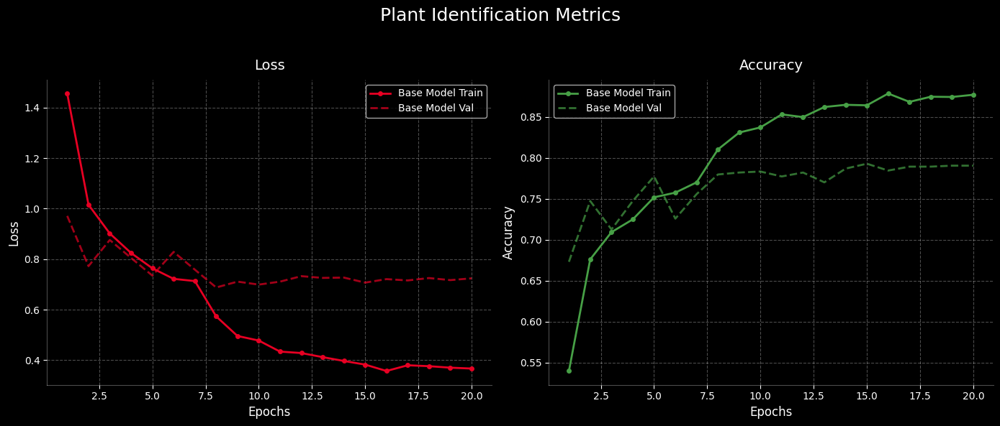

In [67]:
num_epochs = 20
batch_size = 32
lr = 0.01
weight_decay = 0.0005


# Load datasets
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

model = PlantResNetClassifier(num_classes=len(name_encoder.classes_), dropout_rate=0.3).to(device)

optimizer = optim.Adam(
    [p for p in model.parameters() if p.requires_grad],
    lr=lr, weight_decay=weight_decay
)
metric = Metric(PlantMetric.NAME, nn.CrossEntropyLoss())

scheduler = optim.lr_scheduler.StepLR(optimizer, step_size=7, gamma=0.1)

strategy = Classification(metric)

trainer = ModelTrainer(model, train_loader, test_loader, device, strategy, optimizer = optimizer ,scheduler = scheduler)

model, history = trainer.train_model(num_epochs=num_epochs)

plot_training_history({
    'Base Model': [history]
})


It seems our model is learning basic to moderate features. Let's increase the model's capacity to allow the model to learn more complex features

There are multiple ways to increase capacity. We could try adding more training data to the dataset, or add more learnable parameters to the model by increasing the number of layers and/or parameters per layer.

Now before extending the model further, there is another way to increase the capacity given our specific case. Our current resnet layers are frozen and only serve as a feature extractor.

However, we could unfreeze final layers at a later point in the training loop when stagnation occurs, and take advantage of our existing parameters to increase capacity.

To do so, I will introduce `Phases` which will come in handy throughout the rest of the models


In [68]:

class Phase():
    def __init__(self, description, hyperparameters, on_trigger=None):
        self.description = description
        self._on_trigger = on_trigger
        self.hyperparameters = hyperparameters

    def trigger_event(self):
        if self._on_trigger:
            self._on_trigger()
        else:
            print("No trigger event set.")

    def apply_optimizer_update(self, model):
        lr = self.hyperparameters['lr']
        weight_decay = self.hyperparameters['weight_decay']


        optimizer = optim.Adam([p for p in model.parameters() if p.requires_grad],
                               lr=lr, weight_decay=weight_decay)
        return optimizer

    def apply_scheduler_update(self, optimizer):
        step_size = self.hyperparameters['step_size']
        gamma = self.hyperparameters['gamma']

        scheduler = optim.lr_scheduler.StepLR(optimizer, step_size=step_size, gamma=gamma)
        return scheduler



def train_model_phases(self, phases, device=None):
    histories = []

    # Initialize optimizer and scheduler for the first phase
    optimizer = phases[0].apply_optimizer_update(self.model)
    scheduler = phases[0].apply_scheduler_update(self.optimizer)

    for i, phase in enumerate(phases):
        phase.trigger_event()

        self.optimizer = phase.apply_optimizer_update(self.model)

        self.scheduler = phase.apply_scheduler_update(self.optimizer)

        print(f"Phase {i}: {phase.description}")
        model, history = self.train_model(num_epochs=phase.hyperparameters['epochs'])
        histories.append(history)

    return model, histories


ModelTrainer.train_model_phases = train_model_phases

Now let's use the Phases to unfreeze the ResNet layers before the second one and try to tune the hyperparameters appropriately, since in a way it becomes a completely new model from the persepective of training.

Phase 0: Training only the classification head


Phase: 0: 100%|████████████████████████████████████████████████████████████████████████████| 1575/1575 [00:59<00:00, 26.59batch/s]


Phase 1: Fine-tuning with last ResNet layers


Phase: 0: 100%|████████████████████████████████████████████████████████████████████████████| 1575/1575 [01:09<00:00, 22.61batch/s]


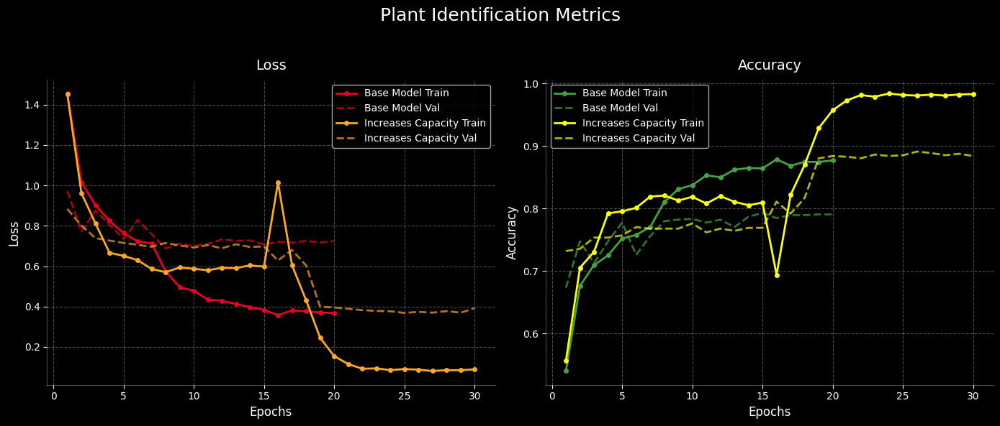

In [69]:
model = PlantResNetClassifier(num_classes=len(name_encoder.classes_), dropout_rate=0.3).to(device)
metric = Metric(PlantMetric.NAME, nn.CrossEntropyLoss())
strategy = Classification(metric)
trainer = ModelTrainer(model, train_loader, test_loader, device, strategy, optimizer, scheduler)

hyperparameters = {
    'epochs': 15,
    'lr': 0.001,
    'weight_decay': 0.0005,
    'step_size': 3,
    'gamma': 0.1
}

phases = [
    Phase(
        description="Training only the classification head",
        hyperparameters=hyperparameters,
        on_trigger=lambda: None
    ),
    Phase(
        description="Fine-tuning with last ResNet layers",
        hyperparameters=hyperparameters,
        on_trigger=lambda: model.unfreeze_last_layer()
    )
]

model_unfrozen, unfrozen_history = trainer.train_model_phases(phases, device=device)

plot_training_history({
    'Base Model': [history],
    'Increases Capacity': unfrozen_history
})



Once the layer is unfrozen, we can notice a drastic increase in training accuracy as while as a significant improvement on validation accuracy. However, while training loss decreases drastically, we also notice a stable increase in validation loss. Great training performance, and increasingly worse test performance is a clear sign of `overfitting`.

Overfitting occurs when a model performs well on training data, but poor on new data (test set), which our model clearly is, meaning it has poor generalization. To counter this, we need to discouirage complexity in our second phase. To do so, we will increase regularization scale by reducing the phase's initial learning rate and increase the weight loss drastiaclly, and increase the dropout rate. Data augmentation has already been applied, and while increasing the volume of training data is possible, for demo purposes here we will keep the same set.

Phase 0: Training only the classification head


Phase: 0: 100%|████████████████████████████████████████████████████████████████████████████| 1050/1050 [00:39<00:00, 26.76batch/s]


Phase 1: Fine-tuning with last ResNet layers


Phase: 0: 100%|████████████████████████████████████████████████████████████████████████████| 2100/2100 [01:31<00:00, 22.88batch/s]


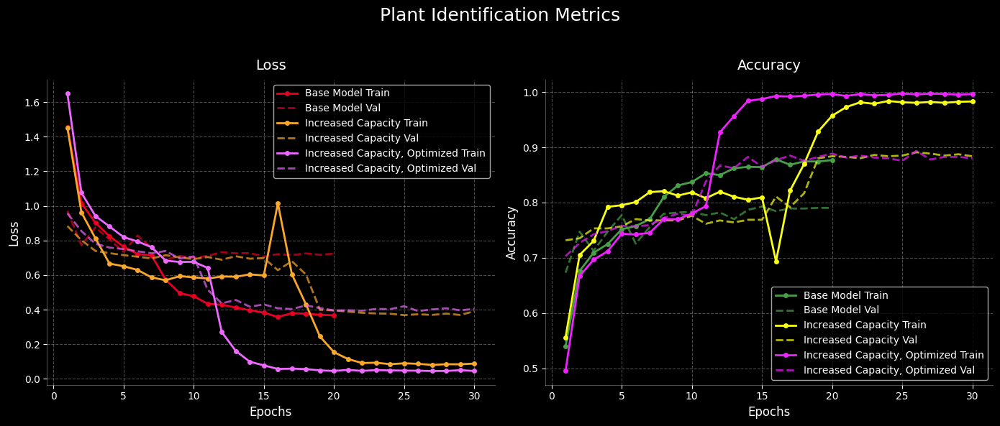

In [70]:
model = PlantResNetClassifier(num_classes=len(name_encoder.classes_), dropout_rate = 0.4).to(device)
metric = Metric(PlantMetric.NAME, nn.CrossEntropyLoss())
strategy = Classification(metric)
trainer = ModelTrainer(model, train_loader, test_loader, device, strategy,optimizer, scheduler)
hyperparameters_phase1 = {
    'epochs': 10,
    'lr': 0.001,
    'weight_decay': 0.0005,
    'step_size': 7,
    'gamma': 0.1
}
hyperparameters_phase2 = {
    'epochs': 20,
    'lr': 0.00001,
    'weight_decay': 0.01,
    'step_size': 3,
    'gamma': 0.2
}

phases = [
    Phase(
        description="Training only the classification head",
        hyperparameters=hyperparameters_phase1,
        on_trigger=lambda: None
    ),
    Phase(
        description="Fine-tuning with last ResNet layers",
        hyperparameters=hyperparameters_phase2,
        on_trigger=lambda: model.unfreeze_last_layer()
    )
]

model, unfrozen_history_reg = trainer.train_model_phases(phases, device=device)

plot_training_history({
    'Base Model': [history],
    'Increased Capacity': unfrozen_history,
    'Increased Capacity, Optimized': unfrozen_history_reg
})

The validation loss now steadily decreases and our model performs relatively well, good enough!

### Plant Care Prediction

Visualization functions: Run the following cells to help visualize model predictions statistics



In [88]:

def predictions_tables(test_loader, model, device, test_transform):

    """
    Displays table comparing actual vs predicted plant metrics for each
    given plant in the test_loader.

    Args:
        test_loader: DataLoader with test data.
        model: Trained PyTorch model.
        device: Device to run inference on.
        test_transform: Transform used during testing (for denormalizing images).
    """

    thresholds = {
        'Watering Interval': (1, 3),
        'Sunlight Hours': (1, 2),
        'Critical Moisture': (5, 10),
        'Temperature': (2, 4),
    }

    def highlight_diff(val_actual, val_pred, col):
        try:
            if isinstance(val_actual, str) or isinstance(val_pred, str):
                return 'background-color: darkgreen; color: white' if val_actual == val_pred else 'background-color: red; color: white'
            else:
                diff = abs(val_actual - val_pred)
                green_thresh, yellow_thresh = thresholds[col]
                if diff < green_thresh:
                    return 'background-color: darkgreen; color: white'
                elif diff < yellow_thresh:
                    return 'background-color: #f5a42e'
                else:
                    return 'background-color: #f44336; color: white'
        except:
            return ''

    def style_results(df, columns_to_style):
        styles = pd.DataFrame('', index=df.index, columns=df.columns)

        for col in columns_to_style:
            for i in df.index:
                val_actual, val_pred = df.at[i, col].split('<br>')
                val_actual = val_actual.replace('(A)', '').strip()
                val_pred = val_pred.replace('(P)', '').strip()
                try:
                    val_actual = float(val_actual)
                    val_pred = float(val_pred)
                except:
                    pass
                styles.at[i, col] = highlight_diff(val_actual, val_pred, col)

        return df.style.apply(lambda _: styles, axis=None).set_properties(subset=['Image'], **{'text-align': 'center'})

    def denormalize_image(tensor):
        normalize = next(
            (t for t in test_transform.transforms if isinstance(t, transforms.Normalize)),
            None
        )
        if normalize is None:
            raise ValueError("No Normalize transform found in test_transform.")

        mean = torch.tensor(normalize.mean).view(3, 1, 1)
        std = torch.tensor(normalize.std).view(3, 1, 1)

        denorm_tensor = tensor.clone() * std + mean
        return torch.clamp(denorm_tensor, 0, 1)

    def tensor_to_pil(tensor):
        denorm_tensor = denormalize_image(tensor)
        return transforms.ToPILImage()(denorm_tensor)

    def image_to_html(img, width=100, height=100):
        if img is None:
            return ""
        img_thumbnail = img.copy()
        img_thumbnail.thumbnail((width, height), Image.LANCZOS)
        buffered = BytesIO()
        img_thumbnail.save(buffered, format="PNG")
        img_str = base64.b64encode(buffered.getvalue()).decode()
        return f'<img src="data:image/png;base64,{img_str}" width="{width}" height="auto">'

    all_results = []
    all_images = []

    with torch.no_grad():
        model.eval()
        for images, labels in test_loader:
            for img_tensor in images:
                all_images.append(img_tensor.clone())
            images = images.to(device)

            watering_interval_actual = labels[0].cpu().numpy().flatten()
            sunlight_hours_actual = labels[1].cpu().numpy().flatten()
            sunlight_type_actual = labels[2].cpu().numpy().flatten()
            critical_moisture_actual = labels[3].cpu().numpy().flatten()
            temperature_actual = labels[4].cpu().numpy().flatten()
            soil_type_actual = labels[5].cpu().numpy().flatten()

            outputs = model(images)
            watering_out = outputs[0].cpu().numpy().flatten()
            sunlight_hours_out = outputs[1].cpu().numpy().flatten()
            sunlight_type_logits = outputs[2]
            moisture_out = outputs[3].cpu().numpy().flatten()
            temperature_out = outputs[4].cpu().numpy().flatten()
            soil_type_logits = outputs[5]

            for i in range(images.size(0)):
                _, sunlight_type_pred = torch.max(sunlight_type_logits[i], dim=0)
                _, soil_type_pred = torch.max(soil_type_logits[i], dim=0)

                result = {
                    'Watering Interval': f"(A) {watering_interval_actual[i]:.2f}<br>(P) {descale_label(normalization_params, watering_out[i], 'watering_interval'):.2f}",
                    'Sunlight Hours': f"(A) {sunlight_hours_actual[i]:.2f}<br>(P) {descale_label(normalization_params, sunlight_hours_out[i], 'sunlight_hours'):.2f}",
                    'Sunlight Type': f"(A) {delabel_categorical(sunlight_type_encoder, sunlight_type_actual[i].item())}<br>(P) {delabel_categorical(sunlight_type_encoder, sunlight_type_pred.item())}",
                    'Critical Moisture': f"(A) {critical_moisture_actual[i]:.2f}<br>(P) {descale_label(normalization_params, moisture_out[i], 'critical_moisture'):.2f}",
                    'Temperature': f"(A) {temperature_actual[i]:.2f}<br>(P) {descale_label(normalization_params, temperature_out[i], 'temperature'):.2f}",
                    'Soil Type': f"(A) {delabel_categorical(soil_type_encoder, soil_type_actual[i].item())}<br>(P) {delabel_categorical(soil_type_encoder, soil_type_pred.item())}",
                }

                all_results.append(result)

    df = pd.DataFrame(all_results)
    pil_images = [tensor_to_pil(img_tensor) for img_tensor in all_images]
    image_html = [image_to_html(img) for img in pil_images]
    df.insert(0, 'Image', image_html)
    columns_to_style = [col for col in df.columns if col != "Image"]
    styled_df = style_results(df, columns_to_style)

    return styled_df

def model_distributions(models_dict, test_loader, normalization_params, metric, device, colors=None):
    """
    Compare distributions of multiple models against actual values.
    Works with both regression and classification metrics.

    Args:
        models_dict: Dictionary with model names as keys and model objects as values
        test_loader: DataLoader for test data
        normalization_params: Parameters for denormalization
        metric: Metric object to evaluate
        device: Device to run models on
        colors: Optional dictionary mapping model names to colors
    """

    is_classification = isinstance(metric.loss, nn.CrossEntropyLoss)

    base_colors = ['cyan', 'magenta', 'yellow', 'red', 'blue', 'orange', 'purple', 'brown']
    colors = colors or {name: base_colors[i % len(base_colors)] for i, name in enumerate(models_dict.keys())}
    all_results = {}
    actual_values_list = []

    for model_name, model in models_dict.items():
        model.eval()
        model_results = []
        with torch.no_grad():
            if len(all_results) == 0:
                for images, labels in test_loader:
                    if images is None:
                        continue

                    labels_for_metric = labels[metric.plant_metric.value]
                    images, labels_for_metric = images.to(device), labels_for_metric.to(device)
                    outputs = model(images)

                    if isinstance(outputs, (tuple, list)):
                        output_tensor = outputs[metric.plant_metric.value]
                    else:
                        output_tensor = outputs

                    if is_classification:
                        _, predicted_classes = torch.max(output_tensor, 1)
                        predicted_vals = predicted_classes.cpu().numpy()
                        actual_vals = labels_for_metric.cpu().numpy()
                    else:
                        predicted_vals = output_tensor.squeeze().detach().cpu().numpy()
                        actual_vals = labels_for_metric.cpu().numpy()

                    for i in range(images.size(0)):
                        if len(actual_values_list) < len(test_loader.dataset):
                            actual_values_list.append(int(actual_vals[i]) if is_classification else float(actual_vals[i]))

                        metric_name = metric.get_name()
                        if is_classification:
                            model_results.append(int(predicted_vals[i]))
                        else:
                            model_results.append(float(descale_label(normalization_params, predicted_vals[i], metric_name)))
            else:
                for images, _ in test_loader:
                    if images is None:
                        continue

                    images = images.to(device)
                    outputs = model(images)

                    if isinstance(outputs, (tuple, list)):
                        output_tensor = outputs[metric.plant_metric.value]
                    else:
                        output_tensor = outputs

                    if is_classification:
                        _, predicted_classes = torch.max(output_tensor, 1)
                        predicted_vals = predicted_classes.cpu().numpy()
                    else:
                        predicted_vals = output_tensor.squeeze().detach().cpu().numpy()

                    for i in range(images.size(0)):
                        metric_name = metric.get_name()
                        if is_classification:
                            model_results.append(int(predicted_vals[i]))
                        else:
                            model_results.append(float(descale_label(normalization_params, predicted_vals[i], metric_name)))

        all_results[model_name] = np.array(model_results)

    actual_values = np.array(actual_values_list)

    plt.figure(figsize=(14, 8))
    ax = plt.subplot(111)
    ax.set_facecolor('black')

    if is_classification:
        unique_classes = np.unique(np.concatenate([actual_values] + list(all_results.values())))
        num_classes = len(unique_classes)


        bar_width = 0.8 / (len(models_dict) + 1)
        index = np.arange(num_classes)

        actual_counts = np.zeros(num_classes)
        for cls in actual_values:
            cls_idx = np.where(unique_classes == cls)[0][0]
            actual_counts[cls_idx] += 1
        actual_dist = actual_counts / len(actual_values)

        ax.bar(index, actual_dist, bar_width, label="Actual", color='green')

        for i, (model_name, predicted_values) in enumerate(all_results.items()):
            model_counts = np.zeros(num_classes)
            for cls in predicted_values:
                cls_idx = np.where(unique_classes == cls)[0][0]
                model_counts[cls_idx] += 1
            model_dist = model_counts / len(predicted_values)

            ax.bar(index + (i+1) * bar_width, model_dist, bar_width,
                  label=model_name, color=colors[model_name])

        ax.set_xlabel('Class')
        ax.set_ylabel('Proportion')
        ax.set_title(f'{metric.get_name()} Classification Distribution')
        ax.set_xticks(index + bar_width * (len(models_dict) + 1) / 2 - bar_width/2)
        ax.set_xticklabels([str(int(cls)) for cls in unique_classes])

    else:
        all_values = np.concatenate([actual_values] + list(all_results.values()))
        x_min = np.min(all_values) - 1
        x_max = np.max(all_values) + 1
        x_range = np.linspace(x_min, x_max, 500)

        kde_actual = gaussian_kde(actual_values)
        y_actual = kde_actual.evaluate(x_range)
        ax.plot(x_range, y_actual, label="Actual", color='green', linewidth=2)

        for model_name, predicted_values in all_results.items():
            kde_pred = gaussian_kde(predicted_values)
            y_pred = kde_pred.evaluate(x_range)
            ax.plot(x_range, y_pred, label=model_name, color=colors[model_name],
                    linestyle='--', linewidth=1.5)

        ax.set_xlabel("Value")
        ax.set_ylabel("Density")
        ax.set_title(f"{metric.get_name()} Distribution Comparison")

    ax.legend(loc='upper right')
    ax.grid(True, alpha=0.3, color='gray', linestyle='--')

    plt.tight_layout()
    plt.savefig(f'{metric.get_name()}_distribution_comparison.png')
    plt.show()

    return all_results, actual_values


Now lets try to apply similar logic to predict each plant's care configurations rather than their names. To do so, we will need a model which will apply regression rather than classification. The following model add's a regression head rather than a classifier to the final layer of ResNet50, also permitting layer unfreezing.

In [72]:
class RegressionHead(nn.Module):
    def __init__(self, in_features, dropout_rate=0.2):
        super(RegressionHead, self).__init__()
        self.model = nn.Sequential(
            nn.Dropout(dropout_rate),
            nn.Linear(in_features, 256),
            nn.ReLU(),
            nn.BatchNorm1d(256),
            nn.Dropout(dropout_rate),
            nn.Linear(256, 128),
            nn.ReLU(),
            nn.BatchNorm1d(128),
            nn.Linear(128, 1)
        )

    def forward(self, x):
        return self.model(x)



class PlantResNetRegressor(nn.Module):
    def __init__(self, dropout_rate=0.4):
        super(PlantResNetRegressor, self).__init__()

        # Load pre-trained ResNet50
        self.resnet = models.resnet50(weights='IMAGENET1K_V1')

        # Freeze all parameters
        for param in self.resnet.parameters():
            param.requires_grad = False

        # Replace the final fully connected layer with regression head
        num_features = self.resnet.fc.in_features
        self.resnet.fc = nn.Identity()

        self.regression_head = RegressionHead(num_features, dropout_rate)

    def forward(self, x):
        features = self.resnet(x)
        return self.regression_head(features)

    def unfreeze_last_layer(self):
        """Unfreeze the last convolutional block for fine-tuning"""
        # Unfreeze layer4 (last ResNet block)
        for param in self.resnet.layer4.parameters():
            param.requires_grad = True


Lets also implement a new ModelTrainer strategy for regression, which will let us try different strategies without cluttering the notebook.

In [73]:
class Regression(EvaluationStrategy):
    def __init__(self, metric: PlantMetric):
        self.metric = metric

    def forward_pass(self, model, images, labels):
        outputs = model(images)
        loss = self.metric.loss(outputs, labels)
        scaled_labels = scale_label(normalization_params, labels, self.metric.get_name())
        scaled_predictions = scale_label(normalization_params, outputs, self.metric.get_name())
        squared_error = ((scaled_predictions - scaled_labels) ** 2).sum().item()
        return loss, squared_error

    def train_epoch(self, model, train_loader, optimizer, progress_bar, device):
        model.train()
        running_loss = 0.0
        total_squared_error = 0.0
        total_samples = 0

        for images, labels in train_loader:
            labels = labels[self.metric.plant_metric.value]
            images, labels = images.to(device), labels.to(device)

            optimizer.zero_grad()
            loss, squared_error = self.forward_pass(model, images, labels)
            loss.backward()
            torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)
            optimizer.step()

            running_loss += loss.item()
            total_squared_error += squared_error
            total_samples += labels.size(0)
            progress_bar.update(1)

        rmse = (total_squared_error / total_samples) ** 0.5
        return running_loss / len(train_loader), rmse

    def evaluate(self, model, test_loader, device):
        model.eval()
        total_loss = 0.0
        total_squared_error = 0.0
        total_samples = 0

        with torch.no_grad():
            for images, labels in test_loader:
                if images is None:
                    continue
                labels = labels[self.metric.plant_metric.value]
                images, labels = images.to(device), labels.to(device)
                labels = scale_label(normalization_params, labels, self.metric.get_name())
                loss, squared_error = self.forward_pass(model, images, labels)

                batch_size = labels.size(0)
                total_loss += loss.item() * batch_size
                total_squared_error += squared_error
                total_samples += batch_size

        avg_loss = total_loss / total_samples
        rmse = (total_squared_error / total_samples) ** 0.5
        return avg_loss, rmse


Let's first try to predict each feature with it's own, tuned model.


Training for watering_interval...
Phase 0: Training head only


Phase: 0: 100%|████████████████████████████████████████████████████████████████████████████| 1050/1050 [00:39<00:00, 26.46batch/s]


Phase 1: ResNet fine-tune


Phase: 0: 100%|████████████████████████████████████████████████████████████████████████████| 1050/1050 [00:48<00:00, 21.80batch/s]



Training for sunlight_hours...
Phase 0: Training head only


Phase: 0: 100%|████████████████████████████████████████████████████████████████████████████| 1050/1050 [00:39<00:00, 26.46batch/s]


Phase 1: ResNet fine-tune


Phase: 0: 100%|████████████████████████████████████████████████████████████████████████████| 1050/1050 [00:48<00:00, 21.76batch/s]



Training for sunlight_type...
Phase 0: Training head only


Phase: 0: 100%|████████████████████████████████████████████████████████████████████████████| 1050/1050 [00:39<00:00, 26.89batch/s]


Phase 1: ResNet fine-tune


Phase: 0: 100%|████████████████████████████████████████████████████████████████████████████| 1050/1050 [00:45<00:00, 22.88batch/s]



Training for critical_moisture...
Phase 0: Training head only


Phase: 0: 100%|████████████████████████████████████████████████████████████████████████████| 1050/1050 [00:39<00:00, 26.44batch/s]


Phase 1: ResNet fine-tune


Phase: 0: 100%|████████████████████████████████████████████████████████████████████████████| 1050/1050 [00:48<00:00, 21.78batch/s]



Training for temperature...
Phase 0: Training head only


Phase: 0: 100%|████████████████████████████████████████████████████████████████████████████| 1050/1050 [00:39<00:00, 26.53batch/s]


Phase 1: ResNet fine-tune


Phase: 0: 100%|████████████████████████████████████████████████████████████████████████████| 1050/1050 [00:48<00:00, 21.81batch/s]



Training for soil_type...
Phase 0: Training head only


Phase: 0: 100%|████████████████████████████████████████████████████████████████████████████| 1050/1050 [00:39<00:00, 26.76batch/s]


Phase 1: ResNet fine-tune


Phase: 0: 100%|████████████████████████████████████████████████████████████████████████████| 1050/1050 [00:45<00:00, 22.86batch/s]


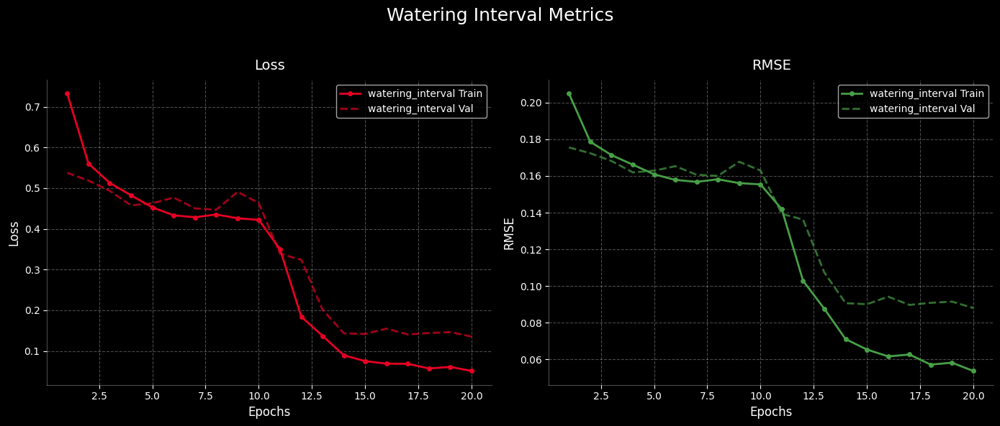

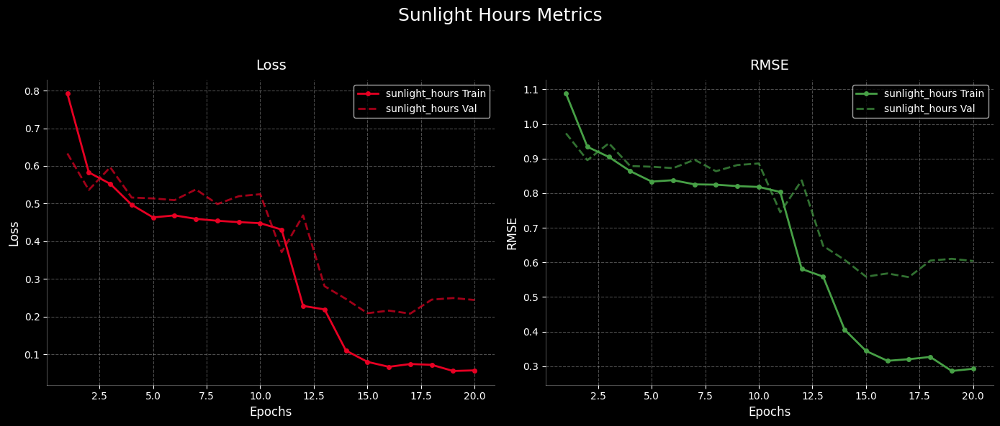

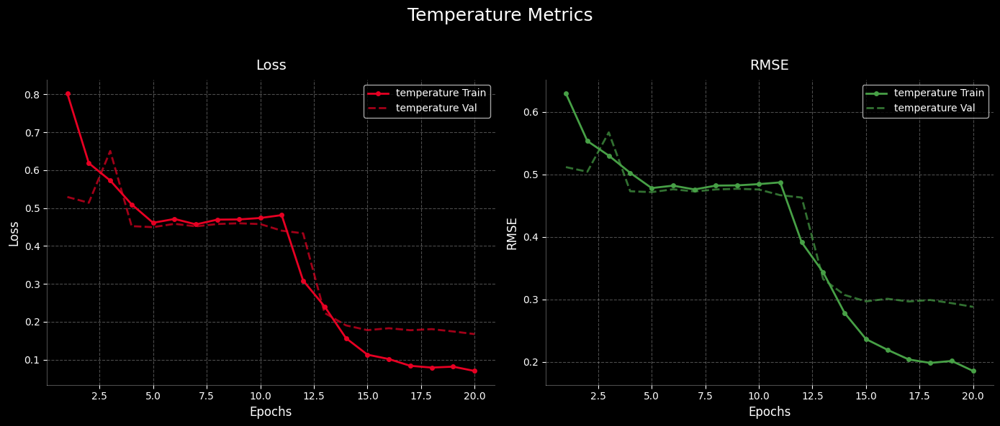

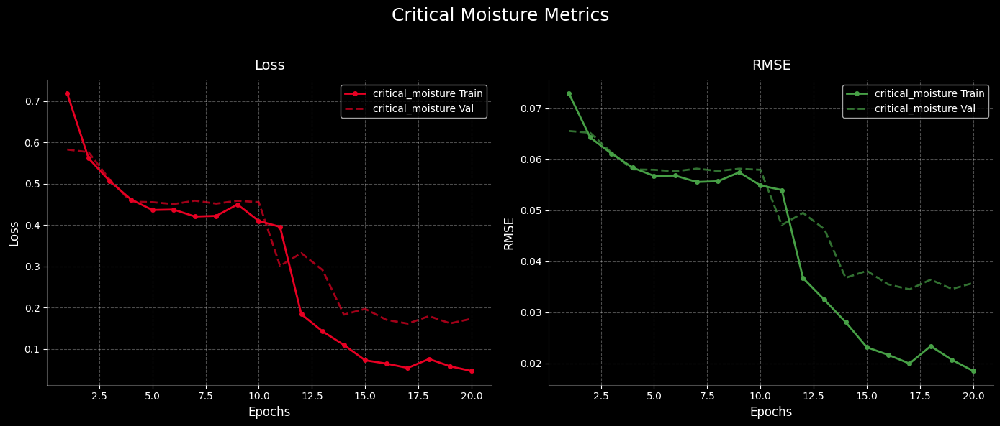

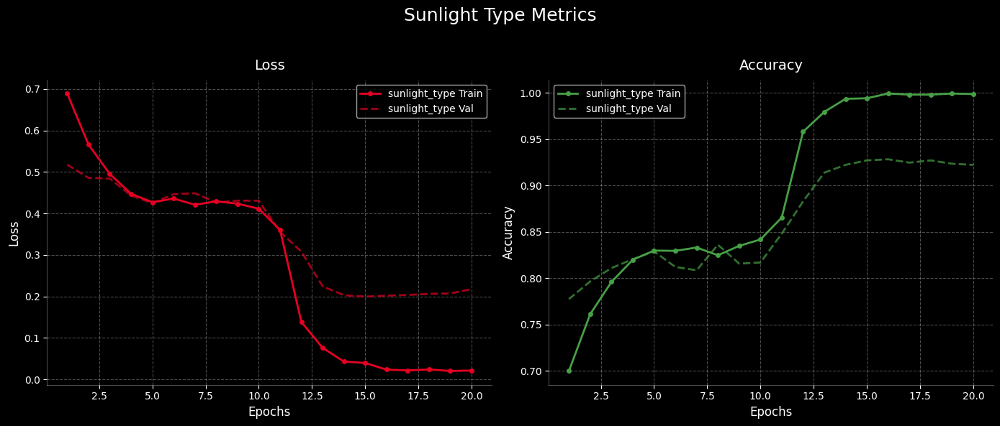

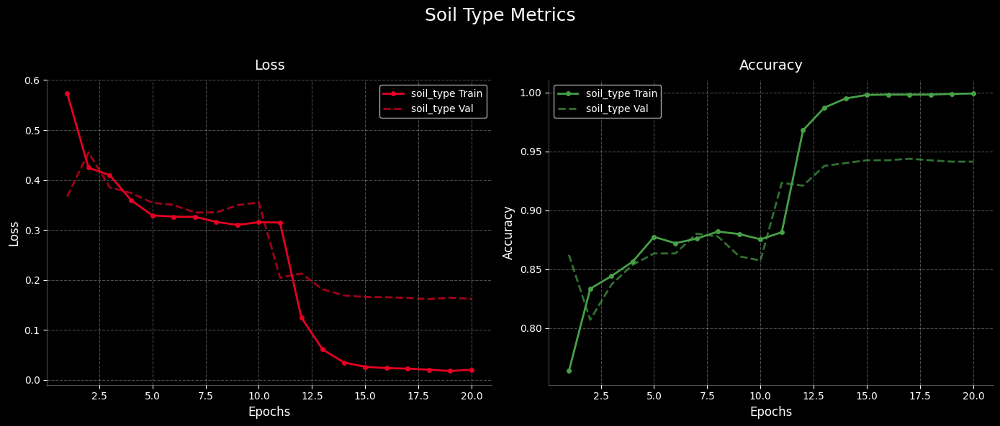

In [74]:

task_configs = [
    {
        'label': 'watering_interval',
        'strategy': Regression(Metric(PlantMetric.WATERING, nn.MSELoss())),
        'model': PlantResNetRegressor(dropout_rate=0.4)
    },
    {
        'label': 'sunlight_hours',
        'strategy': Regression(Metric(PlantMetric.SUNLIGHT_HOURS, nn.MSELoss())),
        'model': PlantResNetRegressor(dropout_rate=0.4)
    },
    {
        'label': 'sunlight_type',
        'strategy': Classification(Metric(PlantMetric.SUNLIGHT_TYPE, nn.CrossEntropyLoss())),
        'model': PlantResNetClassifier(num_classes=len(sunlight_type_encoder.classes_), dropout_rate=0.4)
    },
    {
        'label': 'critical_moisture',
        'strategy': Regression(Metric(PlantMetric.CRITICAL_MOISTURE, nn.MSELoss())),
        'model': PlantResNetRegressor(dropout_rate=0.4)
    },
    {
        'label': 'temperature',
        'strategy': Regression(Metric(PlantMetric.TEMPERATURE, nn.MSELoss())),
        'model': PlantResNetRegressor(dropout_rate=0.4)
    },
    {
        'label': 'soil_type',
        'strategy': Classification(Metric(PlantMetric.SOIL_TYPE, nn.CrossEntropyLoss())),
        'model': PlantResNetClassifier(num_classes=len(soil_type_encoder.classes_), dropout_rate=0.4)
    },

]

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

hyperparameters_phase1 = {
    'epochs': 10,
    'lr': 0.001,
    'weight_decay': 0.0005,
    'step_size': 3,
    'gamma': 0.1
}

hyperparameters_phase2 = {
    'epochs': 10,
    'lr': 0.0001,
    'weight_decay': 0.005,
    'step_size': 3,
    'gamma': 0.2
}

phases = [
    Phase(
        description="Training head only",
        hyperparameters=hyperparameters_phase1,
        on_trigger=lambda: None
    ),
    Phase(
        description="ResNet fine-tune",
        hyperparameters=hyperparameters_phase2,
        on_trigger=lambda: model.unfreeze_last_layer()
    )

]

trained_models = {}
training_histories = {}

for config in task_configs:
    print(f"\nTraining for {config['label']}...")

    model = config['model'].to(device)
    strategy = config['strategy']

    trainer = ModelTrainer(model, train_loader, test_loader, device, strategy)

    trained_model, history = trainer.train_model_phases(phases, device=device)

    trained_models[config['label']] = trained_model
    training_histories[config['label']] = history

plot_training_history({
    'watering_interval': training_histories['watering_interval'],
    'sunlight_hours': training_histories['sunlight_hours'],
    'sunlight_type': training_histories['sunlight_type'],
    'critical_moisture': training_histories['critical_moisture'],
    'temperature': training_histories['temperature'],
    'soil_type': training_histories['soil_type']
})


Now build a wrapper to merge each prediction into one callable model.

In [75]:
class TaskWrapperModel(nn.Module):
    def __init__(self, watering_model=None, sunlight_hours_model=None, sunlight_type_model=None,
                 critical_moisture_model=None, temperature_model=None, soil_type_model=None):
        super(TaskWrapperModel, self).__init__()

        self.models = {
            'watering_interval': watering_model,
            'sunlight_hours': sunlight_hours_model,
            'sunlight_type': sunlight_type_model,
            'critical_moisture': critical_moisture_model,
            'temperature': temperature_model,
            'soil_type': soil_type_model
        }

    def forward(self, x):
        batch_size = x.size(0)
        device = x.device
        outputs = []
        for i, (task, model) in enumerate(self.models.items()):
            out = model(x)
            outputs.append(out)

        # Output structure: (watering_interval, sunlight_hours, sunlight_type, critical_moisture, temperature, soil_type)
        return tuple(outputs)

    def load_weights(self, path, device):
        state_dict = torch.load(path, map_location=torch.device(device))
        self.load_state_dict(state_dict)


Great, we now have a model capable of achieving our goal of predicting plant care features based on a given plant image. Run 'prediciton_tables' to view each test dataset entry and see how the model performs.

Different color coding was assigned based on what is acceptable in a real world scenario.

This visualization method will allow us to find outliers in our dataset.

,Image,Watering Interval,Sunlight Hours,Sunlight Type,Critical Moisture,Temperature,Soil Type
0,,(A) 7.00(P) 6.78,(A) 6.00(P) 6.00,(A) bright_indirect_light(P) bright_indirect_light,(A) 30.00(P) 30.08,(A) 20.00(P) 19.95,(A) potting_mix(P) potting_mix
1,,(A) 3.00(P) 3.13,(A) 6.00(P) 6.07,(A) full_sun(P) full_sun,(A) 40.00(P) 38.19,(A) 18.00(P) 17.98,(A) loamy(P) loamy
2,,(A) 3.00(P) 3.39,(A) 6.00(P) 6.01,(A) bright_indirect_light(P) bright_indirect_light,(A) 50.00(P) 42.83,(A) 20.00(P) 19.59,(A) potting_mix(P) potting_mix
3,,(A) 3.00(P) 4.47,(A) 4.00(P) 4.13,(A) partial_shade(P) partial_shade,(A) 50.00(P) 47.54,(A) 15.00(P) 15.07,(A) loamy(P) loamy
4,,(A) 3.00(P) 3.18,(A) 6.00(P) 6.07,(A) full_sun(P) full_sun,(A) 40.00(P) 39.12,(A) 18.00(P) 18.10,(A) loamy(P) loamy
5,,(A) 10.00(P) 9.91,(A) 6.00(P) 6.01,(A) bright_indirect_light(P) bright_indirect_light,(A) 25.00(P) 24.76,(A) 20.00(P) 20.00,(A) potting_mix(P) potting_mix
6,,(A) 3.00(P) 3.21,(A) 4.00(P) 4.14,(A) partial_shade(P) partial_shade,(A) 50.00(P) 47.42,(A) 15.00(P) 15.52,(A) loamy(P) loamy
7,,(A) 10.00(P) 11.13,(A) 6.00(P) 6.06,(A) bright_indirect_light(P) full_sun,(A) 25.00(P) 20.34,(A) 20.00(P) 19.84,(A) potting_mix(P) cactus_mix
8,,(A) 7.00(P) 5.59,(A) 6.00(P) 5.98,(A) bright_indirect_light(P) bright_indirect_light,(A) 30.00(P) 39.85,(A) 20.00(P) 19.36,(A) potting_mix(P) potting_mix
9,,(A) 3.00(P) 4.07,(A) 6.00(P) 6.00,(A) full_sun(P) full_sun,(A) 40.00(P) 37.75,(A) 18.00(P) 18.00,(A) loamy(P) loamy

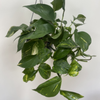
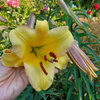
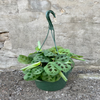
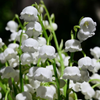
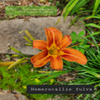
...
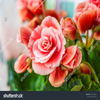
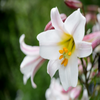
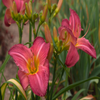
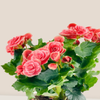
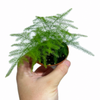

,Image,Watering Interval,Sunlight Hours,Sunlight Type,Critical Moisture,Temperature,Soil Type
0,,(A) 7.00(P) 6.78,(A) 6.00(P) 6.00,(A) bright_indirect_light(P) bright_indirect_light,(A) 30.00(P) 30.08,(A) 20.00(P) 19.95,(A) potting_mix(P) potting_mix
1,,(A) 3.00(P) 3.13,(A) 6.00(P) 6.07,(A) full_sun(P) full_sun,(A) 40.00(P) 38.19,(A) 18.00(P) 17.98,(A) loamy(P) loamy
2,,(A) 3.00(P) 3.39,(A) 6.00(P) 6.01,(A) bright_indirect_light(P) bright_indirect_light,(A) 50.00(P) 42.83,(A) 20.00(P) 19.59,(A) potting_mix(P) potting_mix
3,,(A) 3.00(P) 4.47,(A) 4.00(P) 4.13,(A) partial_shade(P) partial_shade,(A) 50.00(P) 47.54,(A) 15.00(P) 15.07,(A) loamy(P) loamy
4,,(A) 3.00(P) 3.18,(A) 6.00(P) 6.07,(A) full_sun(P) full_sun,(A) 40.00(P) 39.12,(A) 18.00(P) 18.10,(A) loamy(P) loamy
5,,(A) 10.00(P) 9.91,(A) 6.00(P) 6.01,(A) bright_indirect_light(P) bright_indirect_light,(A) 25.00(P) 24.76,(A) 20.00(P) 20.00,(A) potting_mix(P) potting_mix
6,,(A) 3.00(P) 3.21,(A) 4.00(P) 4.14,(A) partial_shade(P) partial_shade,(A) 50.00(P) 47.42,(A) 15.00(P) 15.52,(A) loamy(P) loamy
7,,(A) 10.00(P) 11.13,(A) 6.00(P) 6.06,(A) bright_indirect_light(P) full_sun,(A) 25.00(P) 20.34,(A) 20.00(P) 19.84,(A) potting_mix(P) cactus_mix
8,,(A) 7.00(P) 5.59,(A) 6.00(P) 5.98,(A) bright_indirect_light(P) bright_indirect_light,(A) 30.00(P) 39.85,(A) 20.00(P) 19.36,(A) potting_mix(P) potting_mix
9,,(A) 3.00(P) 4.07,(A) 6.00(P) 6.00,(A) full_sun(P) full_sun,(A) 40.00(P) 37.75,(A) 18.00(P) 18.00,(A) loamy(P) loamy

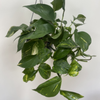
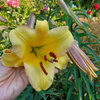
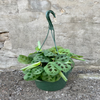
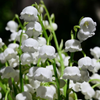
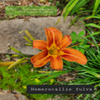
...
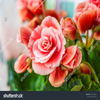
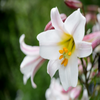
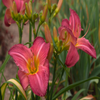
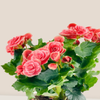
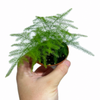

In [76]:
wrapper_model = TaskWrapperModel(
    watering_model=trained_models['watering_interval'],
    sunlight_hours_model=trained_models['sunlight_hours'],
    sunlight_type_model=trained_models['sunlight_type'],
    critical_moisture_model=trained_models['critical_moisture'],
    temperature_model=trained_models['temperature'],
    soil_type_model=trained_models['soil_type']
)

# Save wrapper model
torch.save(model.state_dict(), f'{content_path}.wrapper_model.pth')

predictions_tables(test_loader, wrapper_model, device, test_transform)

Analyzing each entry individualy makes it difficult to understand the general reliability of the model, let's plot a distribution model for each prediction feature. including:
  - `Distribution curves` to understand regression predicted feature distribution against acutal dataset distribution
  - `Bar charts` to compare actual vs predicted class distributions

/tmp/ipykernel_45023/2868261499.py:181: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  actual_values_list.append(int(actual_vals[i]) if is_classification else float(actual_vals[i]))


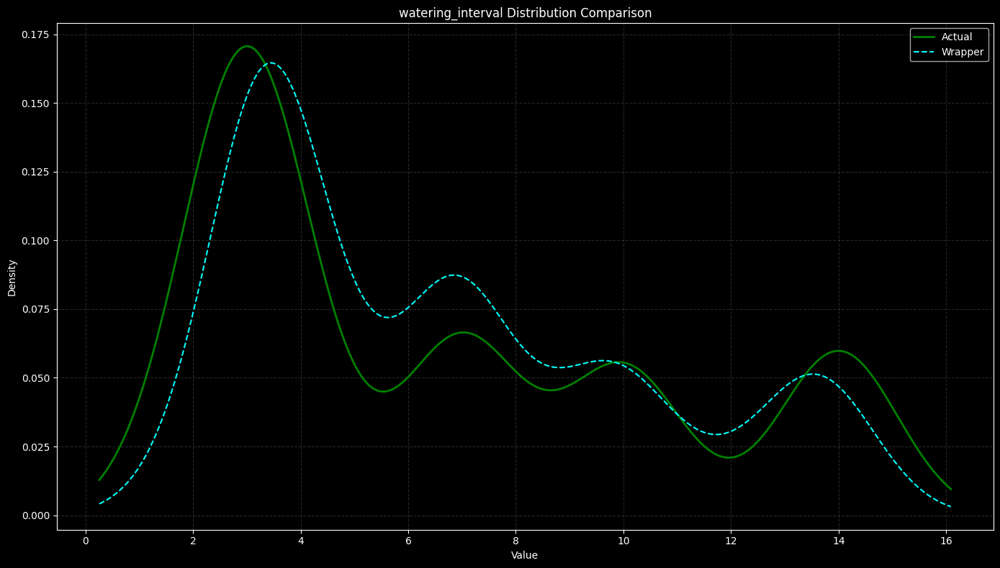

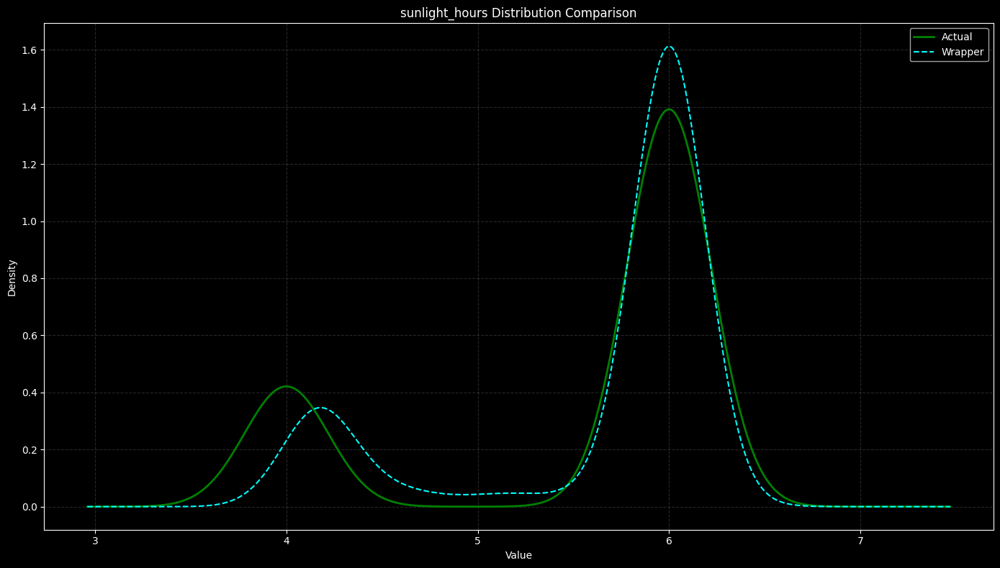

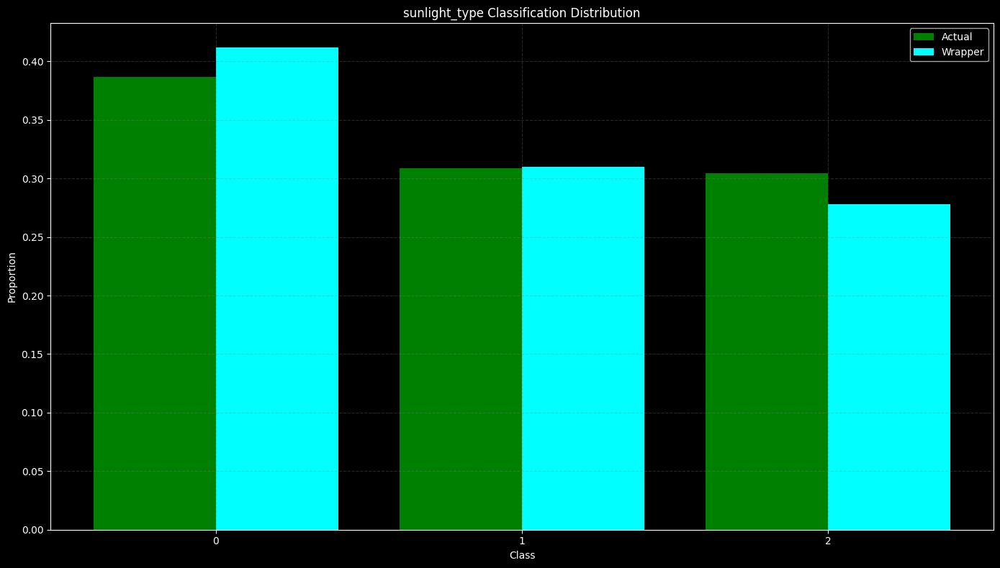

/tmp/ipykernel_45023/2868261499.py:181: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  actual_values_list.append(int(actual_vals[i]) if is_classification else float(actual_vals[i]))


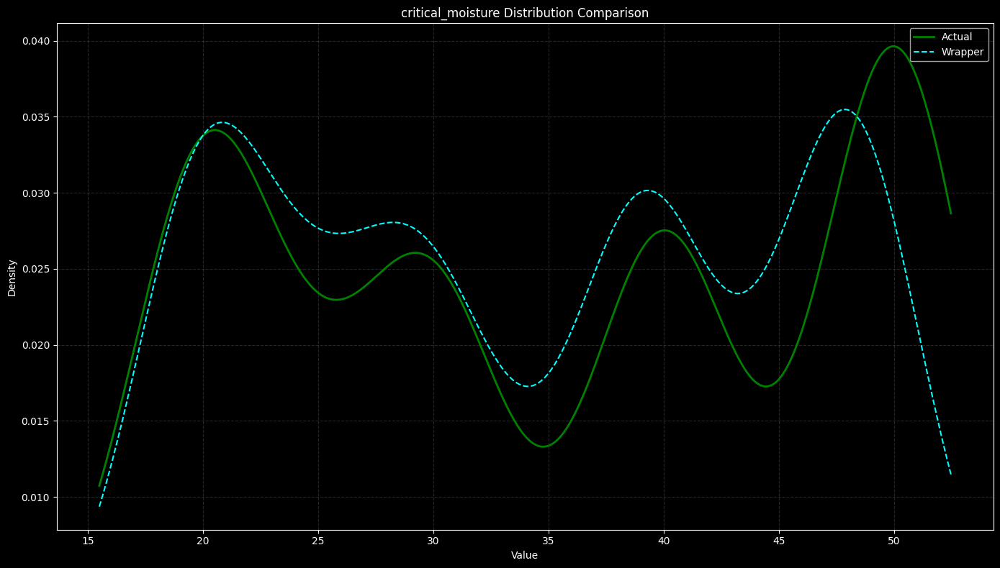

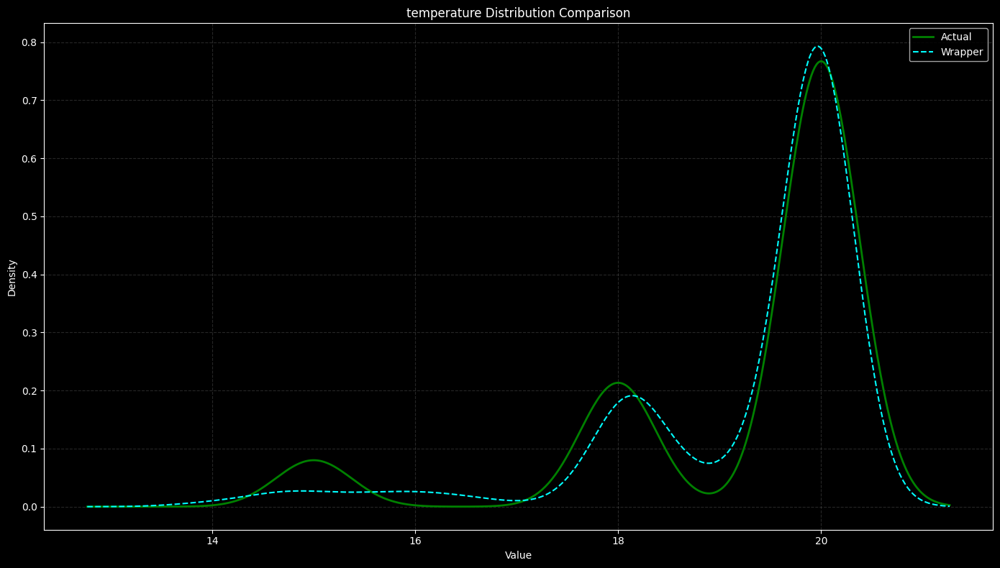

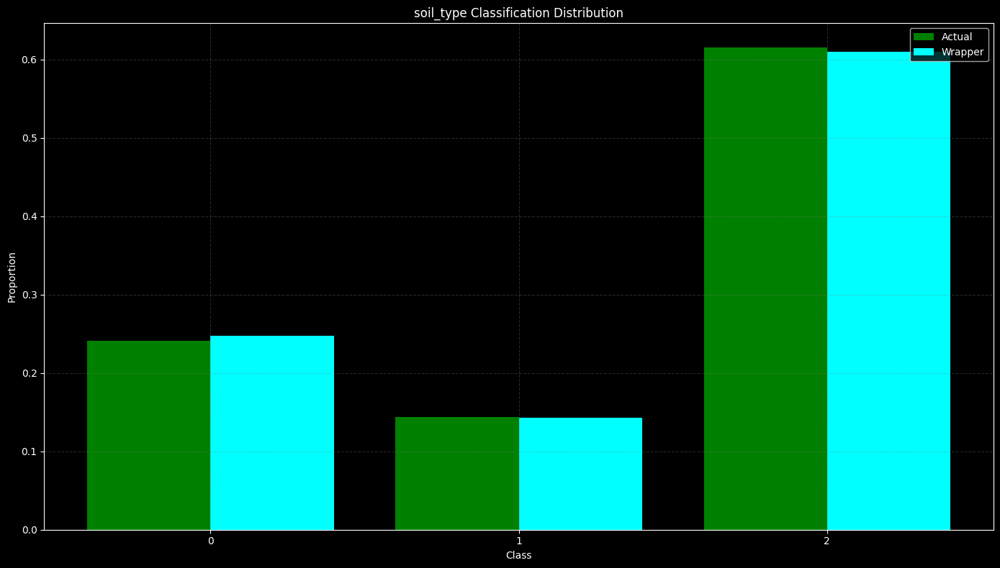

In [77]:
metrics_list = [
    Metric(PlantMetric.WATERING, nn.MSELoss()),
    Metric(PlantMetric.SUNLIGHT_HOURS, nn.MSELoss()),
    Metric(PlantMetric.SUNLIGHT_TYPE, nn.CrossEntropyLoss()),
    Metric(PlantMetric.CRITICAL_MOISTURE, nn.MSELoss()),
    Metric(PlantMetric.TEMPERATURE, nn.MSELoss()),
    Metric(PlantMetric.SOIL_TYPE, nn.CrossEntropyLoss())
]

for metric in metrics_list:
    name = metric.get_name()
    models_plot = {
        'Wrapper': trained_models[name],

    }

    custom_colors = {
        'Wrapper': 'cyan',
    }
    results, actual = model_distributions(
        models_plot,
        test_loader,
        normalization_params,
        metric,
        device,
        colors=custom_colors
    )

### MultiTask model

While our previous model definitiely performs well. It begs the question: How much of each feature's learning is mutual to each other feature?  

If we take a look at the ResNet50, each frozen layer is exatcly the same throughout each model, so at the very least, these should be shared. Now if we think about it, there should be general trends of similarities between each different feature, and therefore possible interdependence of weights and shared features.

A good example to grap this concept would be cactie.

<img src="https://drive.google.com/uc?export=view&id=1lZ4EGM_VDqop2c3Jc7ji_uKJvE7lJVwZ" alt="Image description" width="350"/>

<img src="https://drive.google.com/uc?export=view&id=12cWbiHCy6xJlYU0sqnGesxX6Y5C6QWG4" alt="Image description" width="350"/>

  - Watering cycles: Deserts have low frequency rain cycles, so high watering intervals
  - Sunlight hours: Cactie grow new the equator, meaning constant high exposure to sunlight
  - Sunlight Type: Deserts are arid and dry, not much shade is availalbe, cactie need bright direct sunlight
  - Critical Moisture: Cactie can withstand long periods of dryness, meaning low critical moisture
  - Temperature: Deserts are high in average temperature
  - Soil Type: Sandy, cactus mix

Looking at these characteristics, we can see how a certain feature may strongly imply another based on a plants natural habitat.

That said, lets try to implement MultiTask learning, which will allow the model to simlutaneously learn multiple related tasks by sharing model parameters such as weights. This will enable it to extract correlations between different features which will, at worst, drastically improve training speed and memory usage, and at best, improve generalization for multi feature accuracy and performance assessment. Since this is our goal, lets attempt to optimize this approach.

Define the multitask model, which will have a head for each feature prediction. This implementation shares only resnet layers, which are frozen for until changed. This means that shared weights will only be the unfrozen parameters of the last resnet layer during training

In [78]:
class PlantCareResNetMulti(nn.Module):
      def __init__(self, sunlight_type_classes, soil_type_classes, dropout_rate=0.4):
        super(PlantCareResNetMulti, self).__init__()
        # Load pre-trained ResNet50
        self.resnet = models.resnet50(weights='IMAGENET1K_V1')

        # Freeze all parameters
        for param in self.resnet.parameters():
            param.requires_grad = False

        # Replace the final fully connected layer
        num_features = self.resnet.fc.in_features
        self.resnet.fc = nn.Identity()

        # Add watering interval head
        self.watering_interval_head = RegressionHead(num_features, dropout_rate)
        self.sunlight_hours = RegressionHead(num_features, dropout_rate)
        self.sunlight_type = ClassificationHead(num_features, sunlight_type_classes, dropout_rate)
        self.critical_moisture = RegressionHead(num_features, dropout_rate)
        self.temperature = RegressionHead(num_features, dropout_rate)
        self.soil_type = ClassificationHead(num_features, soil_type_classes, dropout_rate)


      def forward(self, x):
          features = self.resnet(x)
          watering_interval = self.watering_interval_head(features)
          sunlight_hours = self.sunlight_hours(features)
          sunlight_type = self.sunlight_type(features)
          critical_moisture = self.critical_moisture(features)
          temperature = self.temperature(features)
          soil_type = self.soil_type(features)
          return watering_interval, sunlight_hours, sunlight_type, critical_moisture, temperature, soil_type

      def unfreeze_last_layer(self):
          """Unfreeze the last convolutional block for fine-tuning"""
          # Unfreeze layer4 (last ResNet block)
          for param in self.resnet.layer4.parameters():
              param.requires_grad = True

      def load_weights(self, path, device):
          """Load weights from a file"""
          state_dict = torch.load(path, map_location=torch.device(device))
          self.load_state_dict(state_dict)

Implement a new ModelTrainer strategy to adapt for multiple predictions

In [79]:
class MultiTask(EvaluationStrategy):
    def __init__(self, metrics: Metrics):
        self.metrics = metrics

        class MultiTaskMetric:
            def get_name(self):
                return 'multi_task'

        self.metric = MultiTaskMetric()

    def _compute_stats(self, metric, output, label, stats):
        loss = metric.loss(output, label)
        stats["loss"] += loss.item() * output.size(0)

        if isinstance(metric.loss, nn.MSELoss):
            stats["squared_error"] += ((output - label) ** 2).sum().item()
            stats["count"] += label.size(0)
        elif isinstance(metric.loss, nn.CrossEntropyLoss):
            _, predicted = torch.max(output, 1)
            stats["correct"] += (predicted == label).sum().item()
            stats["classification_count"] += label.size(0)
            stats["count"] += label.size(0)
        else:
            raise ValueError(f"Unsupported loss type: {type(metric.loss)}")

    def forward_pass(self, model, images, labels):
        outputs = model(images)
        task_results = []

        for i, metric in enumerate(self.metrics.metrics):
            output = outputs[i]
            label = labels[i]
            loss = metric.loss(output, label)
            task_results.append((metric, output, label, loss))

        return task_results

    def train_epoch(self, model, train_loader, optimizer, progress_bar, device):
        model.train()
        metric_stats = {
            metric.get_name(): {
                "loss": 0.0,
                "squared_error": 0.0,
                "correct": 0,
                "count": 0,
                "classification_count": 0
            }
            for metric in self.metrics.metrics
        }

        for images, labels in train_loader:
            images = images.to(device)
            labels = [labels[metric.plant_metric.value] for metric in self.metrics.metrics]
            labels = [label.to(device) for label in labels]
            optimizer.zero_grad()
            task_results = self.forward_pass(model, images, labels)

            total_loss = 0.0
            losses = []

            for metric, output, label, loss in task_results:
                name = metric.get_name()
                losses.append(loss)
                self._compute_stats(metric, output, label, metric_stats[name])

            total_loss = sum(losses) / len(losses)

            total_loss.backward()
            torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)
            optimizer.step()
            progress_bar.update(1)

        result = {}
        for name, stats in metric_stats.items():
            result[name + "_train"] = {
                "loss": stats["loss"] / stats["count"] if stats["count"] > 0 else 0.0,
            }
            if stats["count"] > 0 and stats["classification_count"] == 0:
                result[name + "_train"]["rmse"] = (stats["squared_error"] / stats["count"]) ** 0.5
            if stats["classification_count"] > 0:
                result[name + "_train"]["accuracy"] = stats["correct"] / stats["classification_count"]

        return sum([v["loss"] for v in result.values()]) / len(result), result


    def evaluate(self, model, test_loader, device):
        model.eval()
        metric_stats = {
            metric.get_name(): {
                "loss": 0.0,
                "squared_error": 0.0,
                "correct": 0,
                "count": 0,
                "classification_count": 0
            }
            for metric in self.metrics.metrics
        }

        with torch.no_grad():
            for images, labels in test_loader:
                images = images.to(device)
                labels = [labels[metric.plant_metric.value] for metric in self.metrics.metrics]
                labels = [label.to(device) for label in labels]

                for metric in self.metrics.metrics:
                    idx = metric.plant_metric.value
                    if metric.get_name() in normalization_params:
                        labels[idx] = scale_label(normalization_params, labels[idx], metric.get_name()).to(device)

                task_results = self.forward_pass(model, images, labels)

                for metric, output, label, _ in task_results:
                    name = metric.get_name()
                    self._compute_stats(metric, output, label, metric_stats[name])

        result = {}
        for name, stats in metric_stats.items():
            result[name + "_val"] = {
                "loss": stats["loss"] / stats["count"] if stats["count"] > 0 else 0.0,
            }
            if stats["count"] > 0 and stats["classification_count"] == 0:
                result[name + "_val"]["rmse"] = (stats["squared_error"] / stats["count"]) ** 0.5
            if stats["classification_count"] > 0:
                result[name + "_val"]["accuracy"] = stats["correct"] / stats["classification_count"]

        return sum([v["loss"] for v in result.values()]) / len(result), result


  Train the Multitask model

In [91]:

metrics = Metrics(metrics_list)

strategy = MultiTask(
    metrics=metrics
)
model = PlantCareResNetMulti(
    sunlight_type_classes=len(sunlight_type_encoder.classes_),
    soil_type_classes=len(soil_type_encoder.classes_), dropout_rate=0.5
).to(device)

trainer = ModelTrainer(model, train_loader, test_loader, device, strategy, optimizer, scheduler)

hyperparameters_phase1 = {
    'epochs': 10,
    'lr': 0.001,
    'weight_decay': 0.0005,
    'step_size': 7,
    'gamma': 0.1
}

hyperparameters_phase2 = {
    'epochs': 10,
    'lr': 0.00001,
    'weight_decay': 0.01,
    'step_size': 3,
    'gamma': 0.2
}

phases = [
    Phase(
        description="Training only the regression head",
        hyperparameters=hyperparameters_phase1,
        on_trigger=lambda: None
    ),
    Phase(
        description="Fine-tuning with last ResNet layers",
        hyperparameters=hyperparameters_phase2,
        on_trigger=lambda: model.unfreeze_last_layer()
    )

]

multi_task_model, multi_task_history = trainer.train_model_phases(phases, device=device)


Phase 0: Training only the regression head


Phase: 0: 100%|████████████████████████████████████████████████████████████████████████████| 1050/1050 [01:16<00:00, 13.76batch/s]


Phase 1: Fine-tuning with last ResNet layers


Phase: 0: 100%|████████████████████████████████████████████████████████████████████████████| 1050/1050 [01:23<00:00, 12.51batch/s]


Inner losses and validation metrics are tracked internally to th model, so must be extracted to comply with our initial plot_training_history display model.

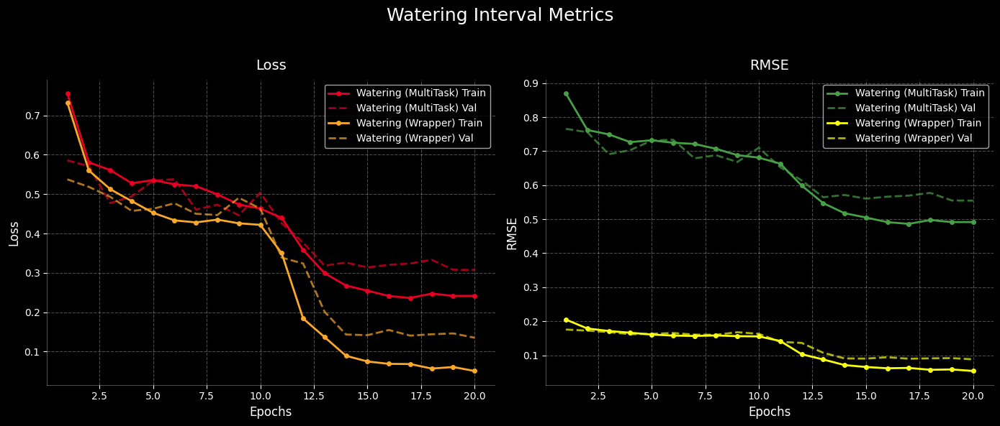

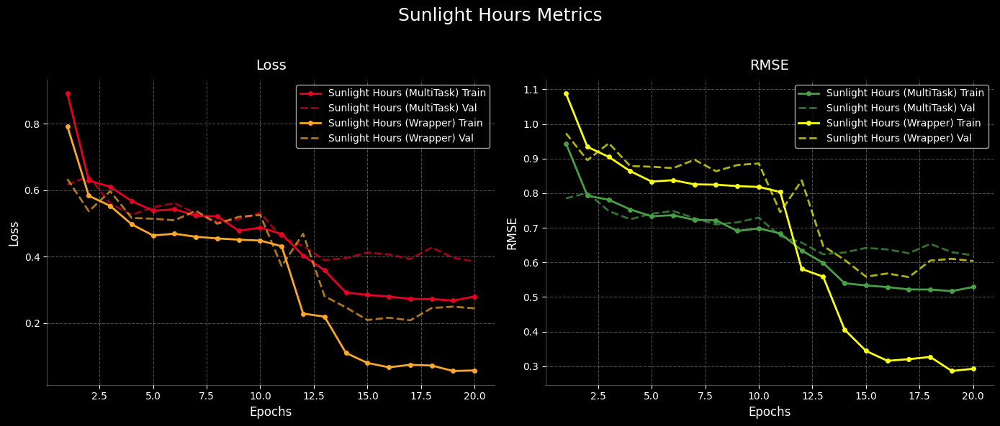

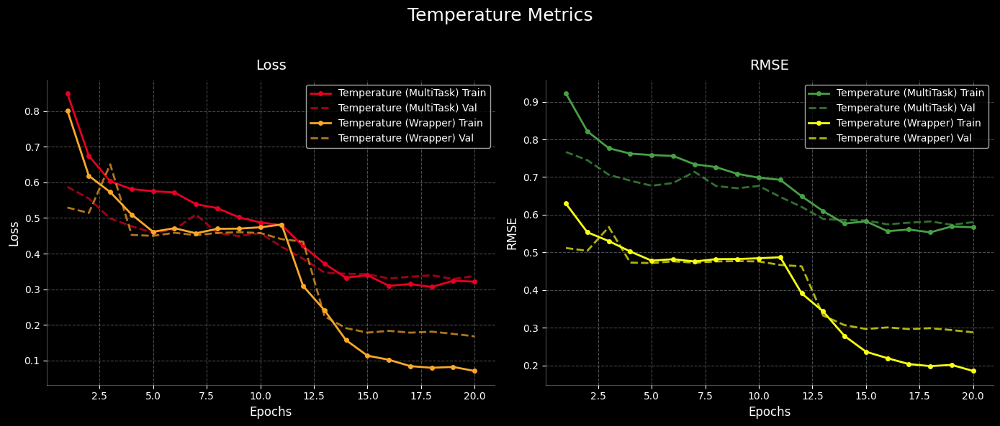

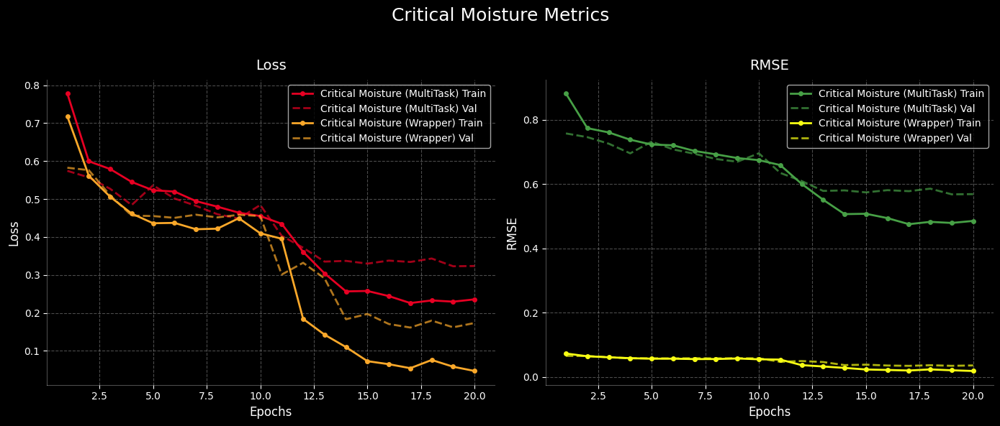

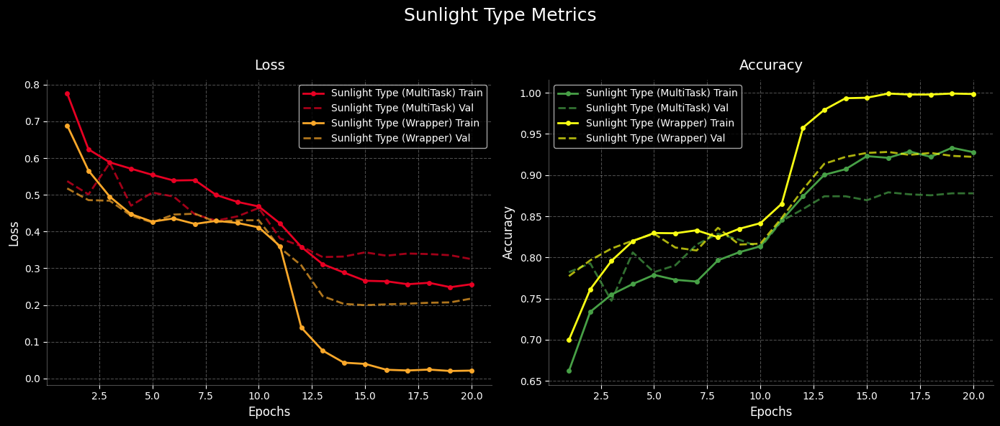

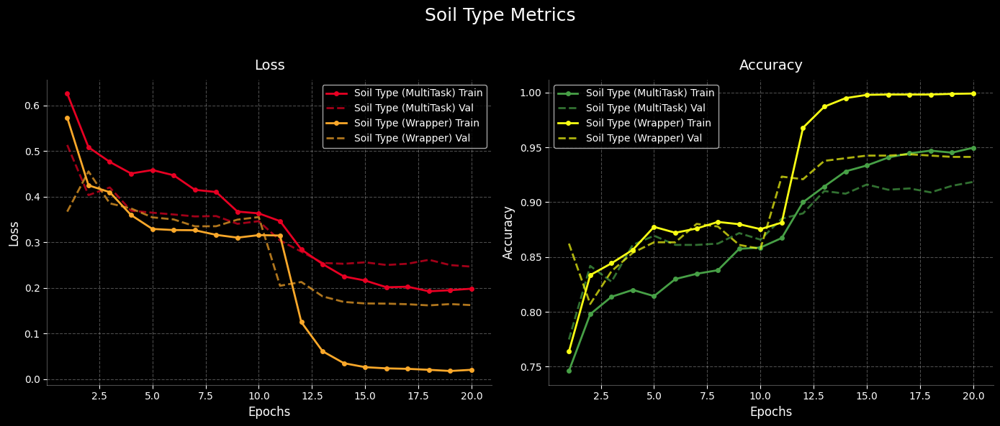

In [90]:
from collections import defaultdict

def convert_to_plot_training_format(history):
    result = defaultdict(lambda: defaultdict(list))
    for h in history:
      for epoch_metrics in h.get('multi_task_val_ind', []):
          for task, metrics in epoch_metrics.items():
              base_task = task.replace('_val', '')
              if 'loss' in metrics:
                  result[base_task][f'{base_task}_val_loss'].append(metrics['loss'])
              if 'rmse' in metrics:
                  result[base_task][f'{base_task}_val_ind'].append(metrics['rmse'])
              elif 'accuracy' in metrics:
                  result[base_task][f'{base_task}_val_ind'].append(metrics['accuracy'])


      for epoch_metrics in h.get('multi_task_train_ind', []):
          for task, metrics in epoch_metrics.items():
              base_task = task.replace('_train', '')

              if 'loss' in metrics:
                  result[base_task][f'{base_task}_train_loss'].append(metrics['loss'])
              if 'rmse' in metrics:
                  result[base_task][f'{base_task}_train_ind'].append(metrics['rmse'])
              elif 'accuracy' in metrics:
                  result[base_task][f'{base_task}_train_ind'].append(metrics['accuracy'])

    return {k: dict(v) for k, v in result.items()}

formated_history = convert_to_plot_training_format(multi_task_history)

plot_training_history({
    'Watering (MultiTask)': [formated_history['watering_interval']],
    'Sunlight Hours (MultiTask)': [formated_history['sunlight_hours']],
    'Sunlight Type (MultiTask)': [formated_history['sunlight_type']],
    'Critical Moisture (MultiTask)': [formated_history['critical_moisture']],
    'Temperature (MultiTask)': [formated_history['temperature']],
    'Soil Type (MultiTask)': [formated_history['soil_type']],
    'Watering (Wrapper)': training_histories['watering_interval'],
    'Sunlight Hours (Wrapper)': training_histories['sunlight_hours'],
    'Sunlight Type (Wrapper)': training_histories['sunlight_type'],
    'Critical Moisture (Wrapper)': training_histories['critical_moisture'],
    'Temperature (Wrapper)': training_histories['temperature'],
    'Soil Type (Wrapper)': training_histories['soil_type']
})


Now lets compare the individual model prediction distribution with our individual model predictor

/tmp/ipykernel_45023/2868261499.py:181: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  actual_values_list.append(int(actual_vals[i]) if is_classification else float(actual_vals[i]))


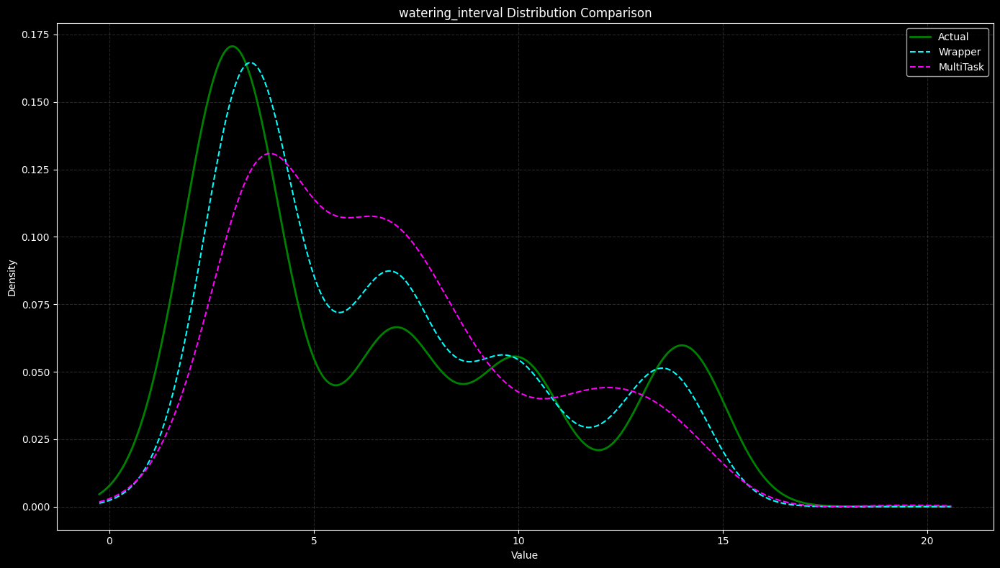

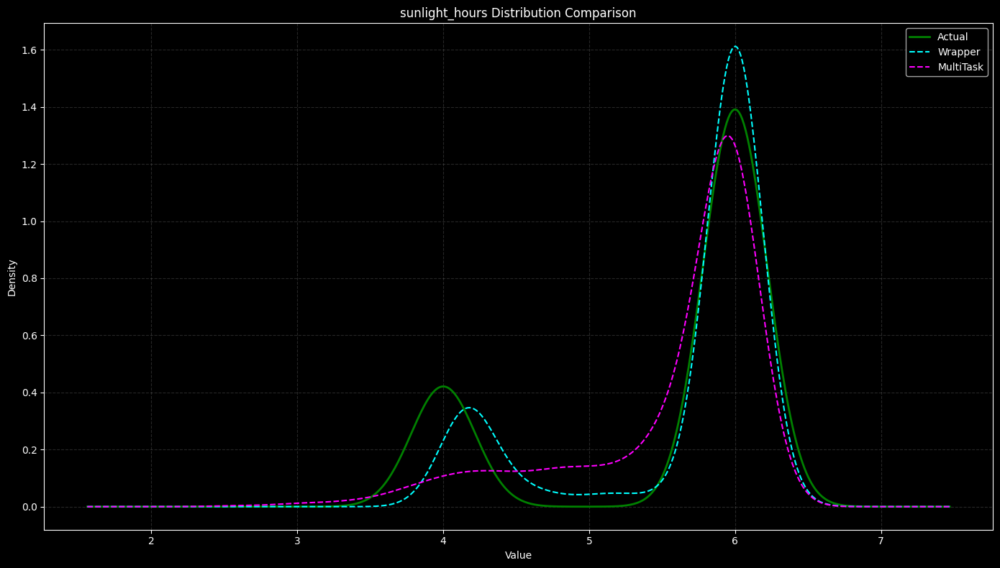

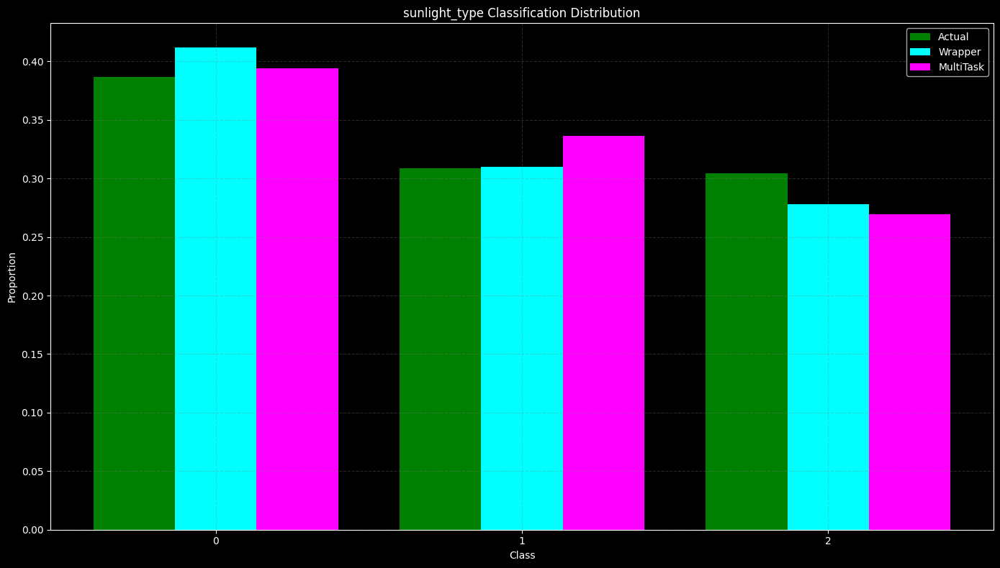

/tmp/ipykernel_45023/2868261499.py:181: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  actual_values_list.append(int(actual_vals[i]) if is_classification else float(actual_vals[i]))


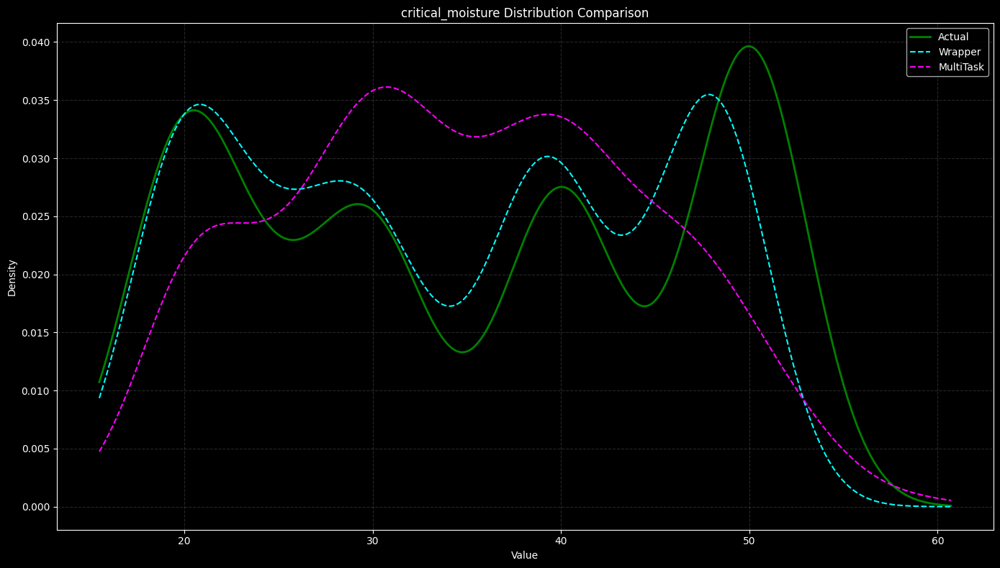

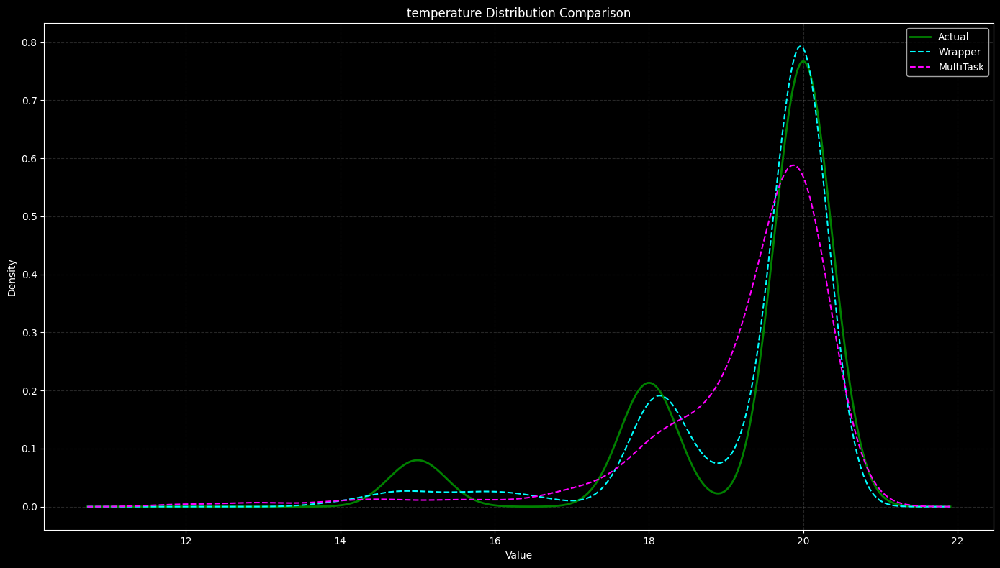

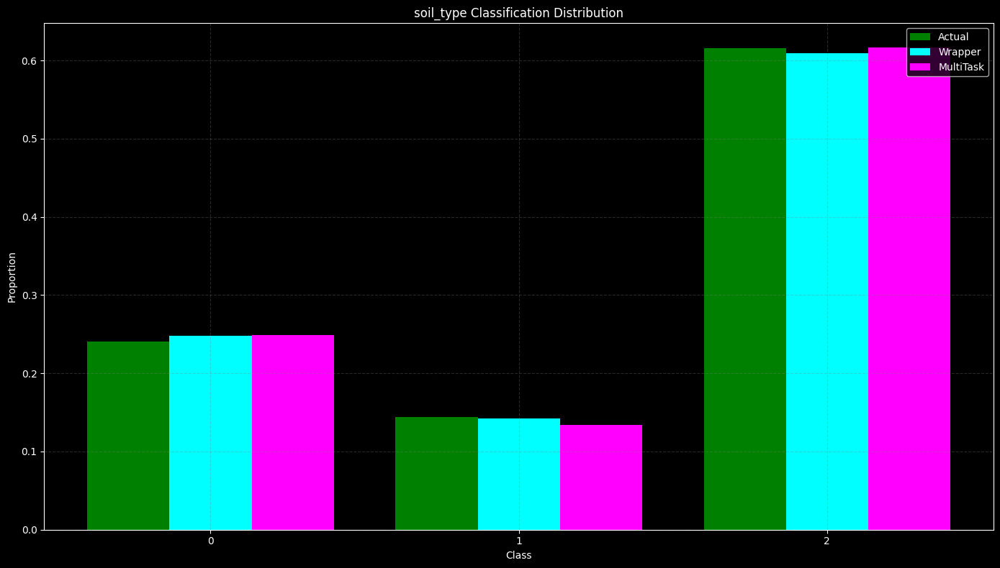

In [82]:
for metric in metrics_list:
    name = metric.get_name()
    models_plot = {
        'Wrapper': trained_models[name],
        'MultiTask': multi_task_model
    }
    custom_colors = {
        'Wrapper': 'cyan',
        'MultiTask': 'magenta'
    }

    results, actual = model_distributions(
        models_plot,
        test_loader,
        normalization_params,
        metric,
        device,
        colors=custom_colors
    )

Right now, the only shared parameters between the different model heads are the unfrozen layers on the second phase of training.

Lets add an additional layer between the each head and the final ResNet50 layer to increase the capacity for shared learning.

In [94]:
class PlantCareResNetMultiShared(nn.Module):
      def __init__(self, sunlight_type_classes, soil_type_classes, dropout_rate=0.4):
        super(PlantCareResNetMultiShared, self).__init__()
        # Load pre-trained ResNet50
        self.resnet = models.resnet50(weights='IMAGENET1K_V1')

        # Freeze all parameters
        for param in self.resnet.parameters():
            param.requires_grad = False

        # Replace the final fully connected layer
        num_features = self.resnet.fc.in_features
        self.resnet.fc = nn.Identity()

        # Add a shared layer before each task head
        self.shared = nn.Sequential(
            nn.Linear(num_features, 1024),
            nn.ReLU(),
            nn.Dropout(dropout_rate),
            nn.Linear(1024, 512),
            nn.ReLU(),
            nn.Dropout(dropout_rate),
            nn.Linear(512, 256),
            nn.ReLU()
        )
        shared_features = self.shared.out_features

        # Add watering interval head
        self.watering_interval_head = RegressionHead(shared_features, dropout_rate)
        self.sunlight_hours = RegressionHead(shared_features, dropout_rate)
        self.sunlight_type = ClassificationHead(shared_features, sunlight_type_classes, dropout_rate)
        self.critical_moisture = RegressionHead(shared_features, dropout_rate)
        self.temperature = RegressionHead(shared_features, dropout_rate)
        self.soil_type = ClassificationHead(shared_features, soil_type_classes, dropout_rate)


      def forward(self, x):
          resnet_features = self.resnet(x)
          features = self.shared(features)
          watering_interval = self.watering_interval_head(features)
          sunlight_hours = self.sunlight_hours(features)
          sunlight_type = self.sunlight_type(features)
          critical_moisture = self.critical_moisture(features)
          temperature = self.temperature(features)
          soil_type = self.soil_type(features)
          return watering_interval, sunlight_hours, sunlight_type, critical_moisture, temperature, soil_type

      def unfreeze_last_layer(self):
          """Unfreeze the last convolutional block for fine-tuning"""
          # Unfreeze layer4 (last ResNet block)
          for param in self.resnet.layer4.parameters():
              param.requires_grad = True

      def unfreeze_all_layers(self):
          """Unfreeze all layers for full fine-tuning"""
          for param in self.resnet.parameters():
              param.requires_grad = True

In [84]:

metrics = Metrics(metrics_list)

strategy = MultiTask(
    metrics=metrics
)
model = PlantCareResNetMulti(
    sunlight_type_classes=len(sunlight_type_encoder.classes_),
    soil_type_classes=len(soil_type_encoder.classes_), dropout_rate=0.4
).to(device)

trainer = ModelTrainer(model, train_loader, test_loader, device, strategy, optimizer, scheduler)

hyperparameters_phase1 = {
    'epochs': 10,
    'lr': 0.001,
    'weight_decay': 0.0005,
    'step_size': 7,
    'gamma': 0.1
}

hyperparameters_phase2 = {
    'epochs': 10,
    'lr': 0.0001,
    'weight_decay': 0.01,
    'step_size': 3,
    'gamma': 0.2
}

phases = [
    Phase(
        description="Training only the regression head",
        hyperparameters=hyperparameters_phase1,
        on_trigger=lambda: None
    ),
    Phase(
        description="Fine-tuning with last ResNet layers",
        hyperparameters=hyperparameters_phase2,
        on_trigger=lambda: model.unfreeze_last_layer()
    )

]

multi_task_shared_model, multi_task_shared_history = trainer.train_model_phases(phases, device=device)

# Save wrapper model
torch.save(model.state_dict(), f'{content_path}.multi_task_shared_model.pth')


Phase 0: Training only the regression head


Phase: 0: 100%|████████████████████████████████████████████████████████████████████████████| 1050/1050 [00:41<00:00, 25.02batch/s]


Phase 1: Fine-tuning with last ResNet layers


Phase: 0: 100%|████████████████████████████████████████████████████████████████████████████| 1050/1050 [00:48<00:00, 21.47batch/s]


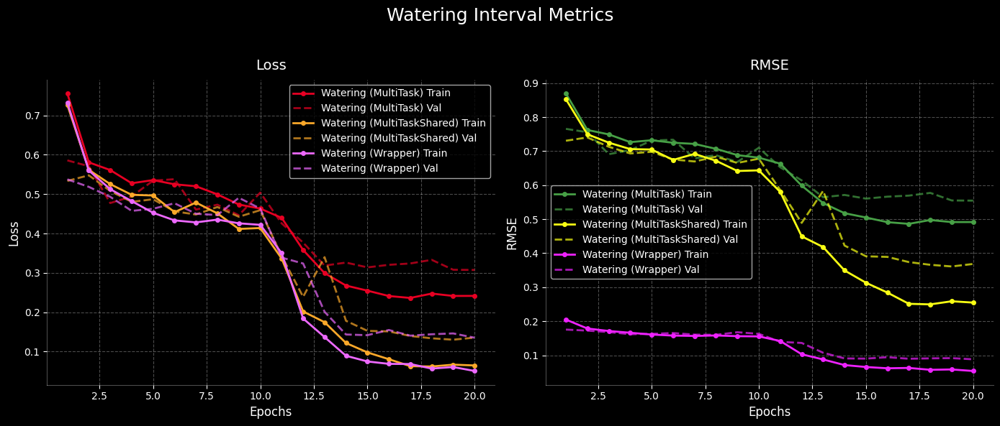

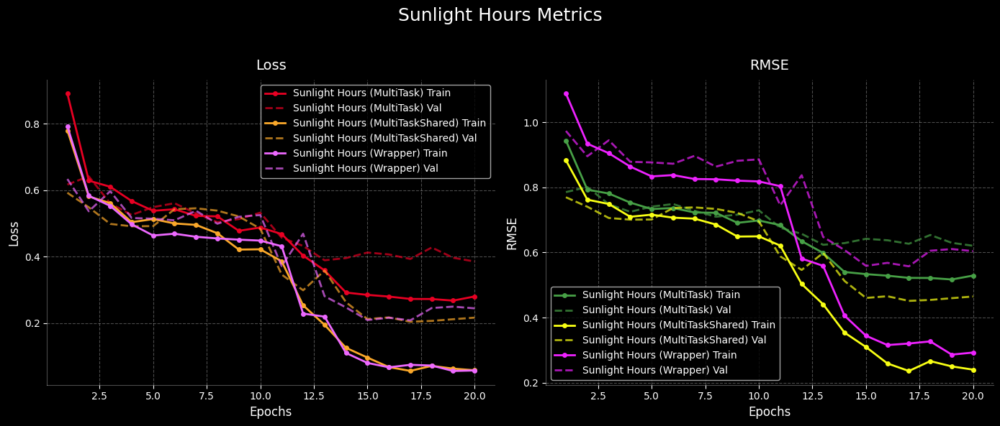

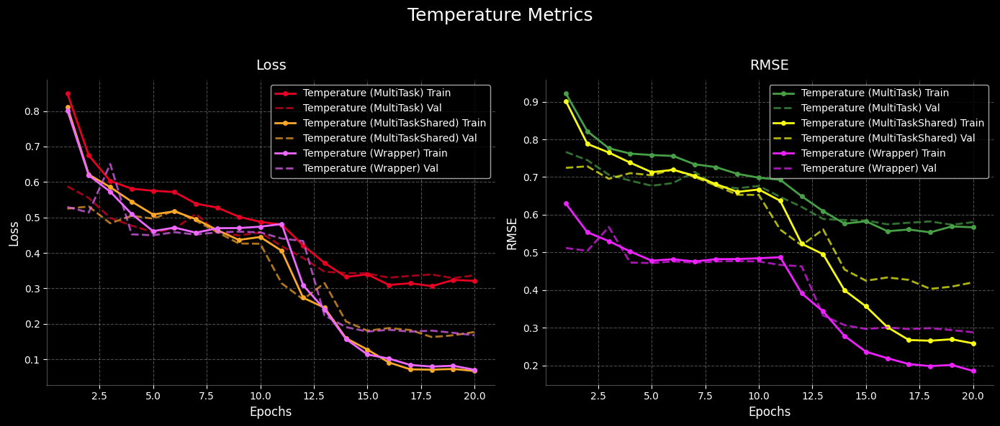

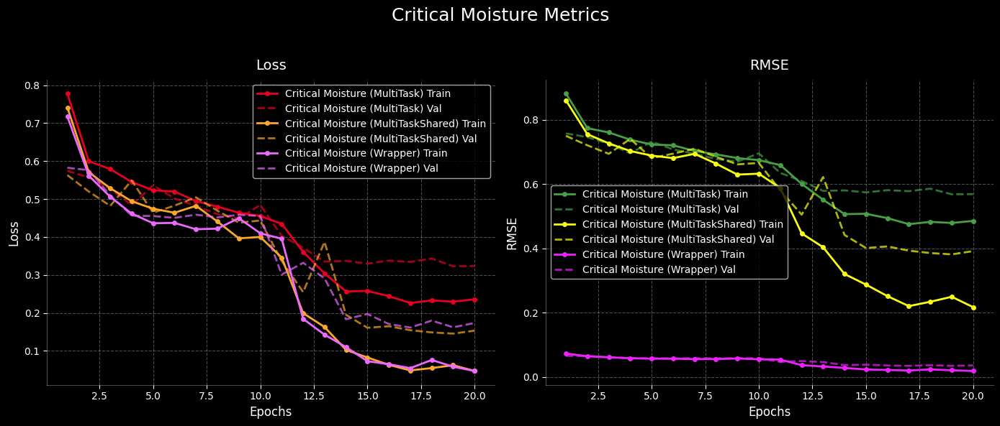

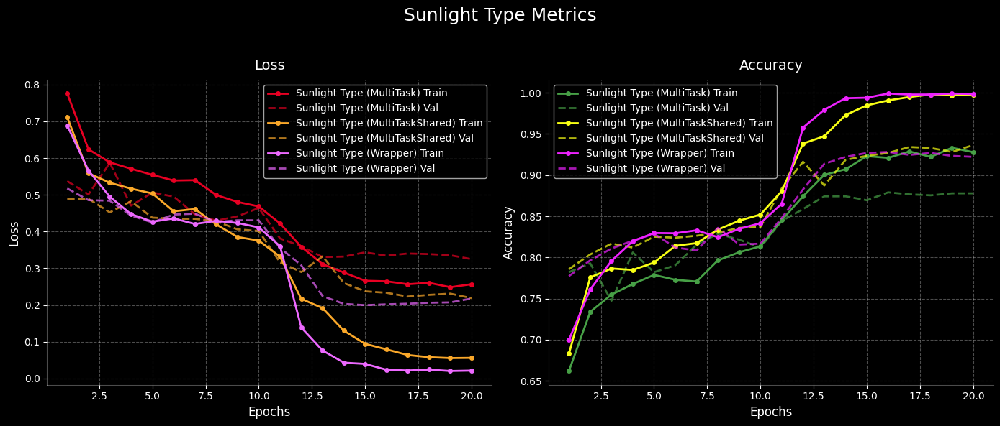

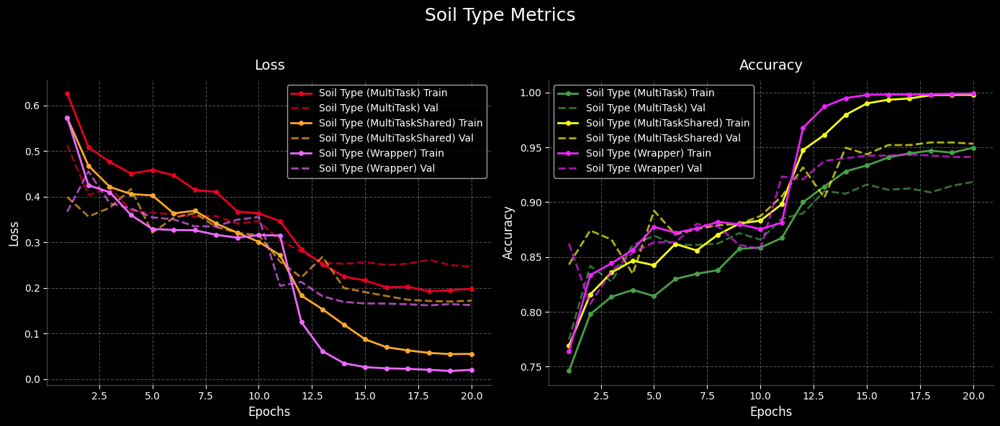

In [92]:
formated_history_shared = convert_to_plot_training_format(multi_task_shared_history)

plot_training_history({
    'Watering (MultiTask)': [formated_history['watering_interval']],
    'Sunlight Hours (MultiTask)': [formated_history['sunlight_hours']],
    'Sunlight Type (MultiTask)': [formated_history['sunlight_type']],
    'Critical Moisture (MultiTask)': [formated_history['critical_moisture']],
    'Temperature (MultiTask)': [formated_history['temperature']],
    'Soil Type (MultiTask)': [formated_history['soil_type']],
    'Watering (MultiTaskShared)': [formated_history_shared['watering_interval']],
    'Sunlight Hours (MultiTaskShared)': [formated_history_shared['sunlight_hours']],
    'Sunlight Type (MultiTaskShared)': [formated_history_shared['sunlight_type']],
    'Critical Moisture (MultiTaskShared)': [formated_history_shared['critical_moisture']],
    'Temperature (MultiTaskShared)': [formated_history_shared['temperature']],
    'Soil Type (MultiTaskShared)': [formated_history_shared['soil_type']],
    'Watering (Wrapper)': training_histories['watering_interval'],
    'Sunlight Hours (Wrapper)': training_histories['sunlight_hours'],
    'Sunlight Type (Wrapper)': training_histories['sunlight_type'],
    'Critical Moisture (Wrapper)': training_histories['critical_moisture'],
    'Temperature (Wrapper)': training_histories['temperature'],
    'Soil Type (Wrapper)': training_histories['soil_type']
})

### Additional Capabilities

Our initial dataset seperates different plants based on their names, but the identification itself no longer interests us. Our model should have learned the different features of a plant which determine it's environmental characterstics regardless of the plant's exact type.

This means we can try feeding plants that the model has never seen before, and still get results.

In [86]:
# Load a new dataset
try:
    from google.colab import drive
    import gdown
    content_path = '/content/data/dataset_all'
    zip_path = '/content/dataset_9k.zip'
    gdown.download(f'https://drive.google.com/uc?id=11GwuYdxFcl867B4xPsUEjcXV5nFprMxR', zip_path, quiet=False)
    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        zip_ref.extractall('/content/data')
except ImportError:
    content_path = '/home/singouini/Projects/Victorin/ml/dataset3/'

# Split test and training dataset
_, test_dataset, _, test_idx = dataset.split_train_test(test_transform, test_size=1)

# Encode labels
name_encoder = LabelEncoder()
soil_type_encoder = LabelEncoder()
sunlight_type_encoder = LabelEncoder()
test_dataset.encode_labels(name_encoder,soil_type_encoder,sunlight_type_encoder)

test_dataset.preload()

test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)



/home/singouini/miniconda3/envs/myenv/lib/python3.9/site-packages/PIL/TiffImagePlugin.py:949: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))


In [89]:

predictions_tables(test_loader, multi_task_model, device, test_transform)